# **SEED**

In [ ]:
import torch
import numpy as np
import random
import os
import gymnasium as gym

# --- The Complete Seeding Code for Full Reproducibility ---

SEED = 42

random.seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED) # For hash-based operations
np.random.seed(SEED)
torch.manual_seed(SEED)

if torch.cuda.is_available():
    torch.cuda.manual_seed(SEED)
    torch.cuda.manual_seed_all(SEED)

    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

print("Seeds have been set for full reproducibility.")

Seeds have been set for full reproducibility.


# **Classes**

In [ ]:
from collections import deque
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

# --- کلاس شبکه عصبی ---
class DQN(nn.Module):
    def __init__(self, state_space_dim, action_space_dim):
        super(DQN, self).__init__()
        self.layer1 = nn.Linear(state_space_dim, 128)
        self.layer2 = nn.Linear(128, 64)
        self.layer3 = nn.Linear(64, action_space_dim)

    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        return self.layer3(x)

# --- کلاس حافظه بازپخش ---
class ReplayBuffer:
    def __init__(self, capacity=100000):
        self.buffer = deque(maxlen=capacity)

    def push(self, transition):
        self.buffer.append(transition)

    def sample(self, batch_size):
        transitions = random.sample(self.buffer, batch_size)
        state, action, reward, next_state, done = zip(*transitions)
        return np.array(state), np.array(action), np.array(reward, dtype=np.float32), np.array(next_state), np.array(done, dtype=np.uint8)

    def __len__(self):
        return len(self.buffer)

# --- تابع ارزیابی نهایی ---
def evaluate_agent_detailed(eval_env, model, model_type, discrete_state_func=None, device=None, num_episodes=100, max_steps=200, discrete_actions=None):
    steps_list = []
    success_count = 0

    for episode in range(num_episodes):
        state, _ = eval_env.reset(seed=SEED + episode + 100000)
        done = False
        episode_steps = 0
        while not done:
            action = None
            if model_type == 'q_table':
                state_discrete = discrete_state_func(state)
                action = np.argmax(model[state_discrete])
            elif model_type == 'dqn':
                state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
                with torch.no_grad():
                    action_index = model(state_tensor).argmax().item()
                if discrete_actions is not None:
                    action = [discrete_actions[action_index]]
                else:
                    action = action_index

            state, reward, terminated, truncated, _ = eval_env.step(action)
            done = terminated or truncated
            episode_steps += 1

            if episode_steps >= max_steps:
                break

        if terminated:
            success_count += 1
            steps_list.append(episode_steps)

    if not steps_list:
        return np.nan, np.nan, 0.0

    avg_steps = np.mean(steps_list)
    std_steps = np.std(steps_list)
    success_rate = (success_count / num_episodes) * 100

    return avg_steps, std_steps, success_rate

print("Classes (DQN, ReplayBuffer) and evaluate_agent_detailed function are defined.")

Classes (DQN, ReplayBuffer) and evaluate_agent_detailed function are defined.


# **Q-Learning**

In [ ]:
!pip install gymnasium
!pip install "gymnasium[classic_control,box2d]"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 374.4/374.4 kB 10.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 65.9 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for box2d-py
  Running setup.py clean for box2d-py
Failed to build box2d-py
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (box2d-py)


In [ ]:
import gymnasium as gym

env = gym.make("MountainCar-v0")

initial_state, info = env.reset()

print(f"حالت اولیه محیط: {initial_state}")
print(f"فضای اقدامات (Actions): {env.action_space}")
print(f"فضای حالات (States): {env.observation_space}")

env.close()

حالت اولیه محیط: [-0.41235882  0.        ]
فضای اقدامات (Actions): Discrete(3)
فضای حالات (States): Box([-1.2  -0.07], [0.6  0.07], (2,), float32)


In [ ]:
import numpy as np

# تعریف تعداد بخش‌ها برای گسسته‌سازی
num_pos_bins = 30
num_vel_bins = 30

pos_space = np.linspace(env.observation_space.low[0], env.observation_space.high[0], num_pos_bins)
vel_space = np.linspace(env.observation_space.low[1], env.observation_space.high[1], num_vel_bins)

q_table = np.zeros((num_pos_bins, num_vel_bins, env.action_space.n))

print("ابعاد جدول Q:", q_table.shape)

ابعاد جدول Q: (30, 30, 3)


--- Starting Q-Learning Training ---
Episode 1000, Epsilon: 0.6065, Avg Reward (last 100): -200.00
Episode 2000, Epsilon: 0.3678, Avg Reward (last 100): -200.00
Episode 3000, Epsilon: 0.2230, Avg Reward (last 100): -194.33
Episode 4000, Epsilon: 0.1353, Avg Reward (last 100): -186.84
Episode 5000, Epsilon: 0.1000, Avg Reward (last 100): -194.21
Episode 6000, Epsilon: 0.1000, Avg Reward (last 100): -185.19
Episode 7000, Epsilon: 0.1000, Avg Reward (last 100): -164.65
Episode 8000, Epsilon: 0.1000, Avg Reward (last 100): -172.37
Episode 9000, Epsilon: 0.1000, Avg Reward (last 100): -181.16
Episode 10000, Epsilon: 0.1000, Avg Reward (last 100): -168.25

Training finished in 109.83 seconds.

--- Evaluating Q-Learning Agent ---
Success Rate: 99.00%
Average Steps to Goal: 172.82 ± 18.50


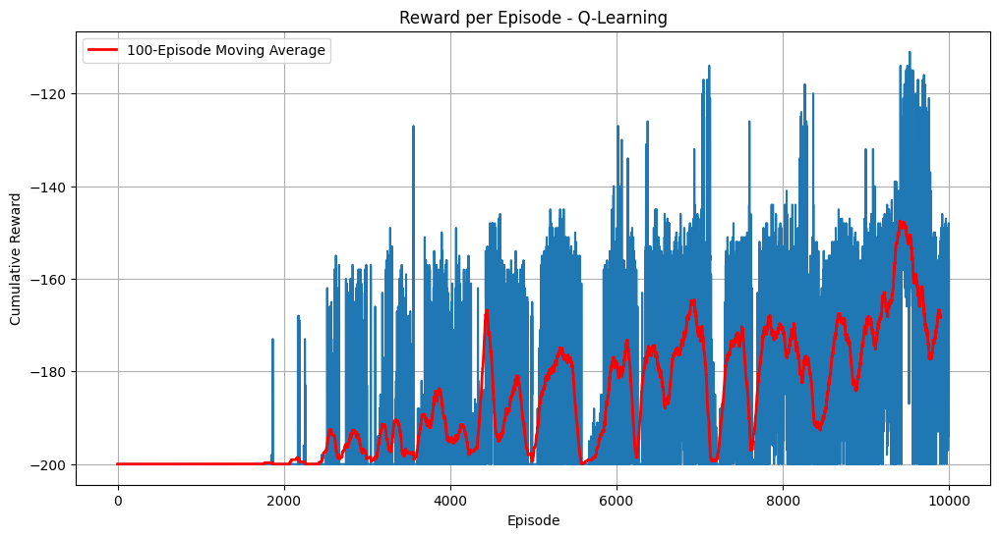

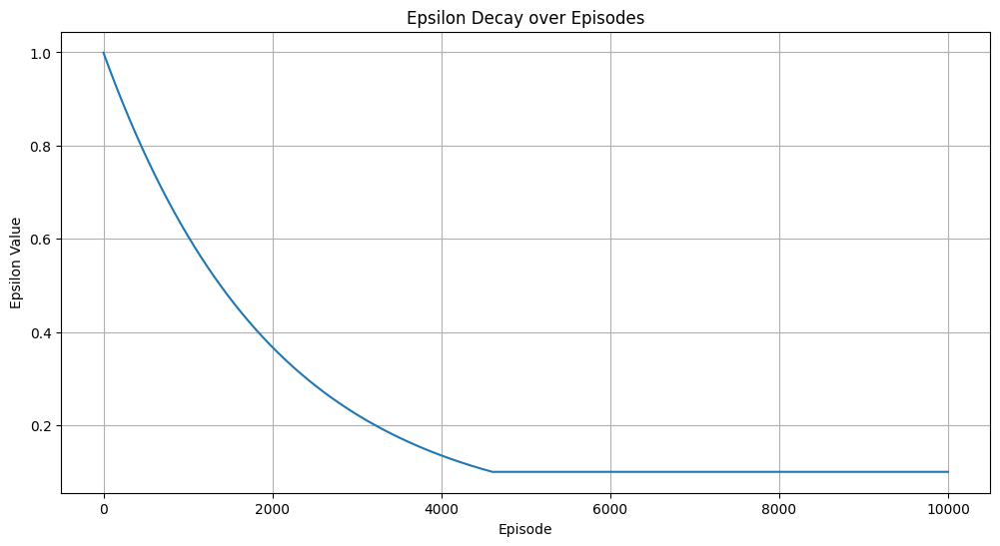

In [ ]:
import time
import matplotlib.pyplot as plt
import numpy as np
import gymnasium as gym

# ==============================================================================
# ---  تعریف محیط و ساختارهای داده ---
# ==============================================================================
env = gym.make("MountainCar-v0")
num_pos_bins = 30
num_vel_bins = 30
pos_space = np.linspace(env.observation_space.low[0], env.observation_space.high[0], num_pos_bins)
vel_space = np.linspace(env.observation_space.low[1], env.observation_space.high[1], num_vel_bins)
q_table = np.zeros((num_pos_bins, num_vel_bins, env.action_space.n))

def get_discrete_state(state):
    position, velocity = state
    pos_bin = np.digitize(position, pos_space) - 1
    vel_bin = np.digitize(velocity, vel_space) - 1
    return (pos_bin, vel_bin)

# ==============================================================================
# ---  حلقه آموزش به همراه زمان‌سنجی و ذخیره نتایج ---
# ==============================================================================
# تعریف هایپرپارامترها
learning_rate = 0.1
discount_factor = 0.99
epsilon = 1.0
epsilon_decay_rate = 0.9995
min_epsilon = 0.1
n_episodes = 10000

# Initialize lists to store metrics
rewards_q_learning = []
epsilon_history = []
results_summary = {}

# Start the timer
print("--- Starting Q-Learning Training ---")
start_time = time.time()

for episode in range(n_episodes):
    state, _ = env.reset(seed=SEED + episode)
    state_discrete = get_discrete_state(state)
    episode_reward = 0

    for step in range(env.spec.max_episode_steps):
        if np.random.random() < epsilon:
            action = env.action_space.sample()
        else:
            action = np.argmax(q_table[state_discrete])

        new_state, reward, terminated, truncated, _ = env.step(action)
        new_state_discrete = get_discrete_state(new_state)
        done = terminated or truncated

        old_q_value = q_table[state_discrete + (action,)]
        next_optimal_q_value = np.max(q_table[new_state_discrete])
        new_q_value = old_q_value + learning_rate * (reward + discount_factor * next_optimal_q_value - old_q_value)
        q_table[state_discrete + (action,)] = new_q_value

        state_discrete = new_state_discrete
        episode_reward += reward

        if done:
            break

    epsilon = max(min_epsilon, epsilon * epsilon_decay_rate)
    rewards_q_learning.append(episode_reward)
    epsilon_history.append(epsilon)

    if (episode + 1) % 1000 == 0:
        last_100_rewards_mean = np.mean(rewards_q_learning[-100:])
        print(f"Episode {episode + 1}, Epsilon: {epsilon:.4f}, Avg Reward (last 100): {last_100_rewards_mean:.2f}")

# Stop the timer and calculate duration
end_time = time.time()
training_time_q_learning = end_time - start_time
print(f"\nTraining finished in {training_time_q_learning:.2f} seconds.")
env.close()

# ==============================================================================
# ---  ارزیابی نهایی مدل آموزش‌دیده ---
# ==============================================================================
print("\n--- Evaluating Q-Learning Agent ---")
eval_env = gym.make("MountainCar-v0")
avg_steps, std_steps, success_rate = evaluate_agent_detailed(
    eval_env, q_table, 'q_table', get_discrete_state
)
eval_env.close()

print(f"Success Rate: {success_rate:.2f}%")
print(f"Average Steps to Goal: {avg_steps:.2f} ± {std_steps:.2f}")

# Store all results in the summary dictionary
results_summary['Q-Learning'] = {
    'training_time': training_time_q_learning,
    'avg_steps': avg_steps,
    'std_steps': std_steps,
    'success_rate': success_rate
}

# ==============================================================================
# ---  رسم نمودارها ---
# ==============================================================================
# نمودار پاداش
plt.figure(figsize=(12, 6))
plt.plot(rewards_q_learning)
plt.title('Reward per Episode - Q-Learning')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
moving_avg = np.convolve(rewards_q_learning, np.ones(100) / 100, mode='valid')
plt.plot(moving_avg, color='red', linewidth=2, label='100-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

# نمودار امتیازی کاهش اپسیلون
plt.figure(figsize=(12, 6))
plt.plot(epsilon_history)
plt.title('Epsilon Decay over Episodes')
plt.xlabel('Episode')
plt.ylabel('Epsilon Value')
plt.grid(True)
plt.show()

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import ArtistAnimation
from IPython.display import HTML

env_render = gym.make("MountainCar-v0", render_mode='rgb_array')

# ریست کردن محیط
state, _ = env_render.reset()
done = False

frames = [] # لیستی برای ذخیره فریم‌های انیمیشن

while not done:
    # دریافت فریم فعلی برای انیمیشن
    frame = env_render.render()
    frames.append(frame)

    # انتخاب بهترین اقدام از جدول Q (بدون اپسیلون)
    state_discrete = get_discrete_state(state)
    action = np.argmax(q_table[state_discrete])

    # اجرای اقدام
    state, reward, terminated, truncated, _ = env_render.step(action)
    done = terminated or truncated

env_render.close()

# ساخت و نمایش انیمیشن
fig = plt.figure()
plt.axis('off')

ims = []
for frame in frames:
    im = plt.imshow(frame, animated=True)
    ims.append([im])

# انیمیشن را با لیست تصاویر (ims) می‌سازیم
anim = ArtistAnimation(fig, ims, interval=30, blit=True, repeat_delay=1000)

plt.close()

HTML(anim.to_jshtml())


# **Double Q-Learning**

In [ ]:
q_table_A = np.zeros((num_pos_bins, num_vel_bins, env.action_space.n))
q_table_B = np.zeros((num_pos_bins, num_vel_bins, env.action_space.n))


print("ابعاد جدول Q_A:", q_table_A.shape)
print("ابعاد جدول Q_B:", q_table_B.shape)

ابعاد جدول Q_A: (30, 30, 3)
ابعاد جدول Q_B: (30, 30, 3)


--- Starting Double Q-Learning Training ---
Episode 1000, Epsilon: 0.6065, Avg Reward (last 100): -200.00
Episode 2000, Epsilon: 0.3678, Avg Reward (last 100): -200.00
Episode 3000, Epsilon: 0.2230, Avg Reward (last 100): -198.91
Episode 4000, Epsilon: 0.1353, Avg Reward (last 100): -199.41
Episode 5000, Epsilon: 0.1000, Avg Reward (last 100): -192.62
Episode 6000, Epsilon: 0.1000, Avg Reward (last 100): -181.79
Episode 7000, Epsilon: 0.1000, Avg Reward (last 100): -194.82
Episode 8000, Epsilon: 0.1000, Avg Reward (last 100): -197.93
Episode 9000, Epsilon: 0.1000, Avg Reward (last 100): -159.42
Episode 10000, Epsilon: 0.1000, Avg Reward (last 100): -158.10

Training finished in 84.42 seconds.

--- Evaluating Double Q-Learning Agent ---
Success Rate: 88.00%
Average Steps to Goal: 156.74 ± 20.25


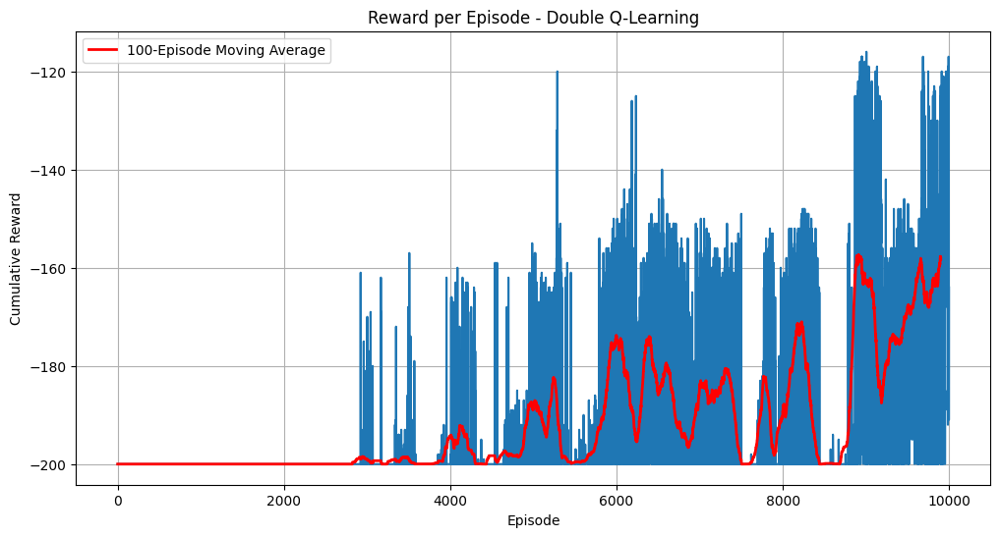

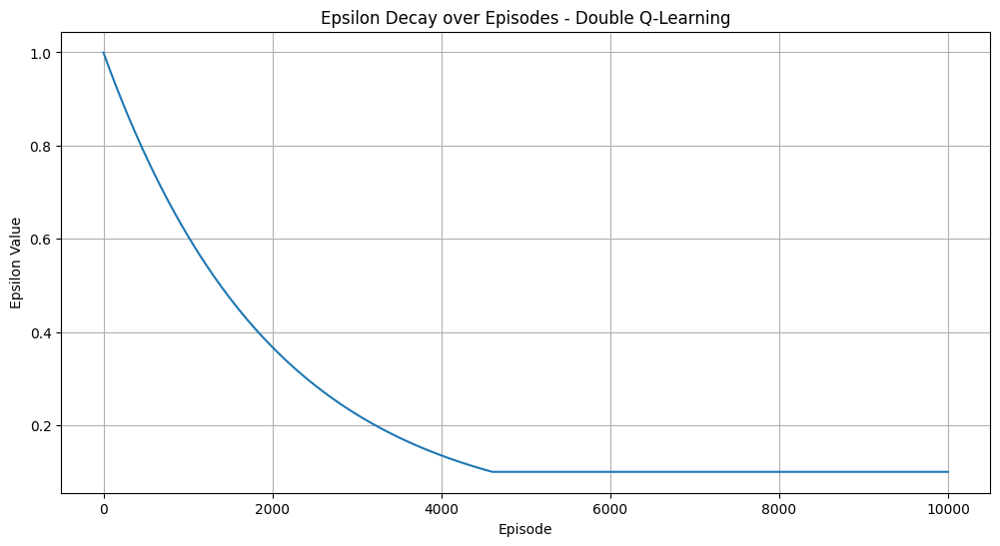

In [ ]:
import time
import matplotlib.pyplot as plt
import numpy as np
import gymnasium as gym

# ==============================================================================
# ---  تعریف محیط و ساختارهای داده ---
# ==============================================================================
# Note: We re-initialize these to ensure this cell runs independently
env = gym.make("MountainCar-v0")
q_table_A = np.zeros((num_pos_bins, num_vel_bins, env.action_space.n))
q_table_B = np.zeros((num_pos_bins, num_vel_bins, env.action_space.n))

# ==============================================================================
# ---  حلقه آموزش به همراه زمان‌سنجی و ذخیره نتایج ---
# ==============================================================================
# Hyperparameters are inherited from the previous cell, but we reset epsilon
epsilon = 1.0

# Initialize lists to store metrics
rewards_double_q = []
epsilon_history_double_q = []

#  Start the timer
print("--- Starting Double Q-Learning Training ---")
start_time = time.time()

for episode in range(n_episodes):
    # Seed the environment reset
    state, _ = env.reset(seed=SEED + episode)
    state_discrete = get_discrete_state(state)
    episode_reward = 0

    for step in range(env.spec.max_episode_steps):
        if np.random.random() < epsilon:
            action = env.action_space.sample()
        else:
            # Action selection is based on the sum of both Q-tables
            action = np.argmax(q_table_A[state_discrete] + q_table_B[state_discrete])

        new_state, reward, terminated, truncated, _ = env.step(action)
        new_state_discrete = get_discrete_state(new_state)
        done = terminated or truncated

        # Randomly choose to update Q_A or Q_B
        if np.random.random() < 0.5:
            best_action_A = np.argmax(q_table_A[new_state_discrete])
            q_value_from_B = q_table_B[new_state_discrete + (best_action_A,)]
            old_q_value = q_table_A[state_discrete + (action,)]
            new_q_value = old_q_value + learning_rate * (reward + discount_factor * q_value_from_B - old_q_value)
            q_table_A[state_discrete + (action,)] = new_q_value
        else:
            best_action_B = np.argmax(q_table_B[new_state_discrete])
            q_value_from_A = q_table_A[new_state_discrete + (best_action_B,)]
            old_q_value = q_table_B[state_discrete + (action,)]
            new_q_value = old_q_value + learning_rate * (reward + discount_factor * q_value_from_A - old_q_value)
            q_table_B[state_discrete + (action,)] = new_q_value

        state_discrete = new_state_discrete
        episode_reward += reward

        if done:
            break

    epsilon = max(min_epsilon, epsilon * epsilon_decay_rate)
    rewards_double_q.append(episode_reward)
    epsilon_history_double_q.append(epsilon) #Store epsilon

    if (episode + 1) % 1000 == 0:
        last_100_rewards_mean = np.mean(rewards_double_q[-100:])
        print(f"Episode {episode + 1}, Epsilon: {epsilon:.4f}, Avg Reward (last 100): {last_100_rewards_mean:.2f}")

#  Stop the timer
end_time = time.time()
training_time_double_q = end_time - start_time
print(f"\nTraining finished in {training_time_double_q:.2f} seconds.")
env.close()

# ==============================================================================
# ---  ارزیابی نهایی مدل آموزش‌دیده ---
# ==============================================================================

print("\n--- Evaluating Double Q-Learning Agent ---")
eval_env = gym.make("MountainCar-v0")
# For evaluation, we use the combined knowledge of both tables
combined_q_table = q_table_A + q_table_B
avg_steps_dq, std_steps_dq, success_rate_dq = evaluate_agent_detailed(
    eval_env, combined_q_table, 'q_table', get_discrete_state
)
eval_env.close()

print(f"Success Rate: {success_rate_dq:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dq:.2f} ± {std_steps_dq:.2f}")

# Store results
results_summary['Double Q-Learning'] = {
    'training_time': training_time_double_q,
    'avg_steps': avg_steps_dq,
    'std_steps': std_steps_dq,
    'success_rate': success_rate_dq
}

# ==============================================================================
# ---  رسم نمودارها ---
# ==============================================================================
# نمودار پاداش
plt.figure(figsize=(12, 6))
plt.plot(rewards_double_q)
plt.title('Reward per Episode - Double Q-Learning')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
moving_avg_dq = np.convolve(rewards_double_q, np.ones(100) / 100, mode='valid')
plt.plot(moving_avg_dq, color='red', linewidth=2, label='100-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

# نمودار کاهش اپسیلون
plt.figure(figsize=(12, 6))
plt.plot(epsilon_history_double_q)
plt.title('Epsilon Decay over Episodes - Double Q-Learning')
plt.xlabel('Episode')
plt.ylabel('Epsilon Value')
plt.grid(True)
plt.show()

In [ ]:
# Create a new render environment
env_render = gym.make("MountainCar-v0", render_mode='rgb_array')
state, _ = env_render.reset()
done = False
frames = []

while not done:
    frame = env_render.render()
    frames.append(frame)

    # Get the best action based on the sum of the two Q-tables
    state_discrete = get_discrete_state(state)
    action = np.argmax(q_table_A[state_discrete] + q_table_B[state_discrete])

    state, reward, terminated, truncated, _ = env_render.step(action)
    done = terminated or truncated

env_render.close()

# --- Animation Creation Code ---
fig = plt.figure()
plt.axis('off')

ims = []
for frame in frames:
    im = plt.imshow(frame, animated=True)
    ims.append([im])

anim = ArtistAnimation(fig, ims, interval=30, blit=True, repeat_delay=1000)
plt.close()

HTML(anim.to_jshtml())

# **Deep Q-Network**

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from collections import deque
import random

# Define the Deep Q-Network architecture
class DQN(nn.Module):
    def __init__(self, state_space_dim, action_space_dim):
        super(DQN, self).__init__()

        self.layer1 = nn.Linear(state_space_dim, 128)
        self.layer2 = nn.Linear(128, 64)
        self.layer3 = nn.Linear(64, action_space_dim)

    def forward(self, x):

        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        return self.layer3(x)

# Define the Replay Buffer
class ReplayBuffer:
    def __init__(self, capacity=100000):
        self.buffer = deque(maxlen=capacity)

    def push(self, transition):
        self.buffer.append(transition)

    def sample(self, batch_size): #
        transitions = random.sample(self.buffer, batch_size)
        # This converts a list of transitions into a batch of states, actions, etc.
        state, action, reward, next_state, done = zip(*transitions)
        return np.array(state), np.array(action), np.array(reward, dtype=np.float32), np.array(next_state), np.array(done, dtype=np.uint8)

    def __len__(self):
        return len(self.buffer)


# --- Test the setup ---
# Get state and action space dimensions from the environment
env = gym.make("MountainCar-v0")
state_dim = env.observation_space.shape[0]
action_dim = env.action_space.n
env.close()

# Create a DQN instance and a ReplayBuffer instance
dqn_model = DQN(state_dim, action_dim)
replay_buffer = ReplayBuffer()

print("DQN Model Architecture:")
print(dqn_model)
print("\nReplay Buffer initialized with capacity:", replay_buffer.buffer.maxlen)

DQN Model Architecture:
DQN(
  (layer1): Linear(in_features=2, out_features=128, bias=True)
  (layer2): Linear(in_features=128, out_features=64, bias=True)
  (layer3): Linear(in_features=64, out_features=3, bias=True)
)

Replay Buffer initialized with capacity: 100000


--- Starting DQN Training (Experiment 1: Adam + MSE) ---
Episode 50/500, Epsilon: 0.7783, Avg Reward (last 50): -200.00
Episode 100/500, Epsilon: 0.6058, Avg Reward (last 50): -200.00
Episode 150/500, Epsilon: 0.4715, Avg Reward (last 50): -200.00
Episode 200/500, Epsilon: 0.3670, Avg Reward (last 50): -200.00
Episode 250/500, Epsilon: 0.2856, Avg Reward (last 50): -200.00
Episode 300/500, Epsilon: 0.2223, Avg Reward (last 50): -200.00
Episode 350/500, Epsilon: 0.1730, Avg Reward (last 50): -199.52
Episode 400/500, Epsilon: 0.1347, Avg Reward (last 50): -191.96
Episode 450/500, Epsilon: 0.1048, Avg Reward (last 50): -175.34
Episode 500/500, Epsilon: 0.0816, Avg Reward (last 50): -173.50

Training finished in 226.68 seconds.

--- Evaluating DQN Agent (Adam + MSE) ---
Success Rate: 39.00%
Average Steps to Goal: 123.74 ± 5.00


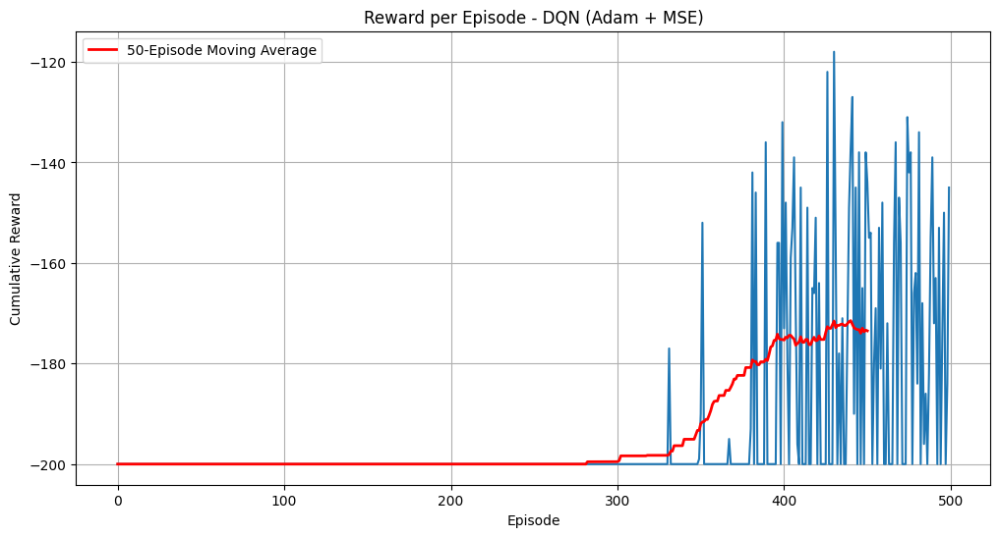

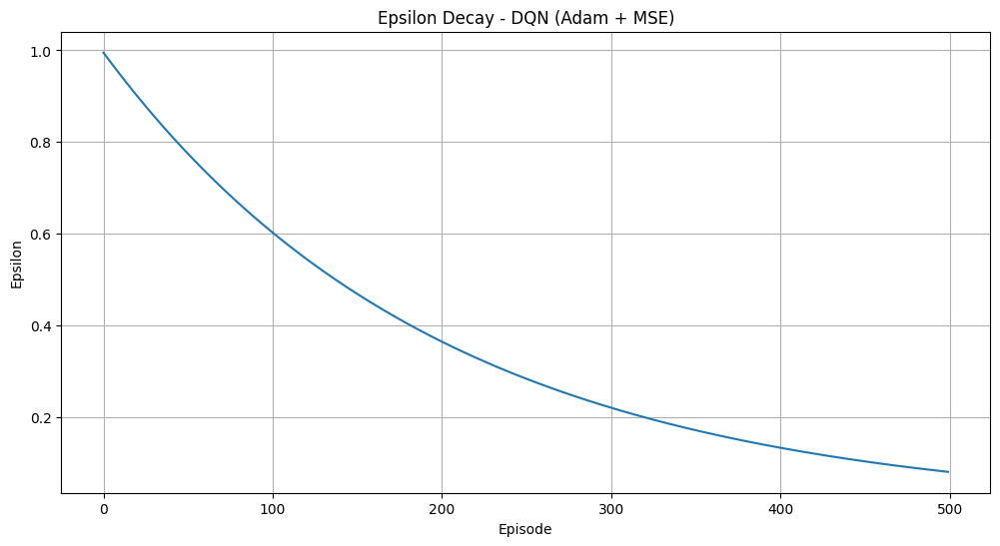

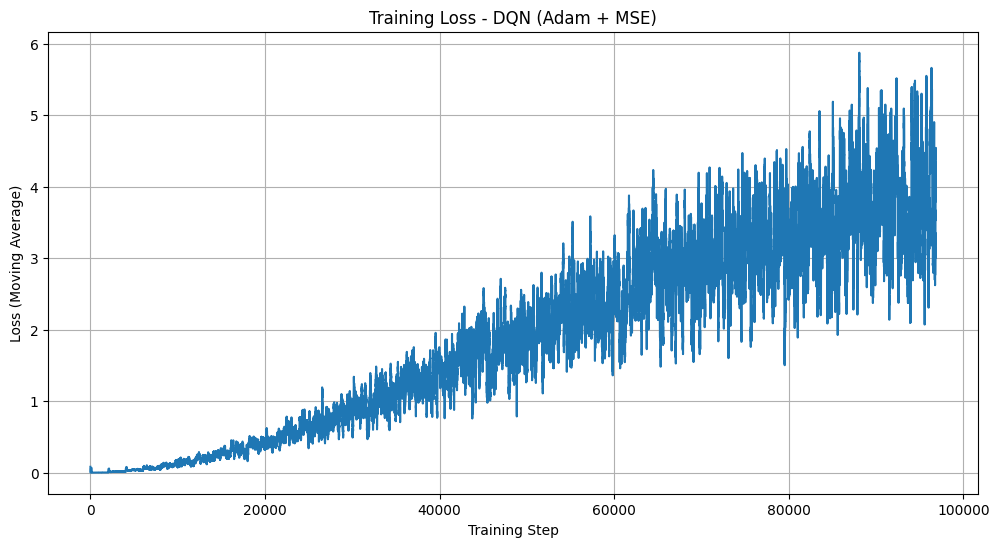

In [ ]:
import time
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np
import gymnasium as gym

# ==============================================================================
# ---  تعریف هایپرپارامترها و شبکه‌ها ---
# ==============================================================================

GAMMA = 0.99
EPSILON_START = 1.0
EPSILON_END = 0.01
EPSILON_DECAY = 0.995
N_EPISODES = 500
LEARNING_RATE = 0.001
BATCH_SIZE = 64
TARGET_UPDATE_FREQUENCY = 10
MAX_STEPS_DQN = 200

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
env = gym.make("MountainCar-v0")
state_dim = env.observation_space.shape[0]
action_dim = env.action_space.n

# Initialize networks, buffer, and optimizer
policy_net = DQN(state_dim, action_dim).to(device)
target_net = DQN(state_dim, action_dim).to(device)
target_net.load_state_dict(policy_net.state_dict())
target_net.eval()
optimizer = optim.Adam(policy_net.parameters(), lr=LEARNING_RATE)
replay_buffer = ReplayBuffer()

# ==============================================================================
# ---  حلقه آموزش ---
# ==============================================================================
print("--- Starting DQN Training (Experiment 1: Adam + MSE) ---")

# Initialize lists for metrics
rewards_dqn1 = []
epsilon_history_dqn1 = []
losses_dqn1 = [] # For the bonus plot

# Start the timer
start_time = time.time()

epsilon = EPSILON_START
for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0

    for step in range(MAX_STEPS_DQN):
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)

        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                action = policy_net(state_tensor).argmax().item()

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated
        episode_reward += reward

        replay_buffer.push((state, action, reward, next_state, done))
        state = next_state

        if len(replay_buffer) > BATCH_SIZE:
            states_np, actions_np, rewards_np, next_states_np, dones_np = replay_buffer.sample(BATCH_SIZE)
            states_tensor = torch.FloatTensor(states_np).to(device)
            actions_tensor = torch.LongTensor(actions_np).to(device)
            rewards_tensor = torch.FloatTensor(rewards_np).to(device)
            next_states_tensor = torch.FloatTensor(next_states_np).to(device)
            dones_tensor = torch.BoolTensor(dones_np).to(device)

            predicted_q_values = policy_net(states_tensor).gather(1, actions_tensor.unsqueeze(1))

            with torch.no_grad():
                next_q_values = target_net(next_states_tensor).max(1)[0]
                next_q_values[dones_tensor] = 0.0
                target_q_values = rewards_tensor + (GAMMA * next_q_values)

            loss = F.mse_loss(predicted_q_values.squeeze(), target_q_values)
            losses_dqn1.append(loss.item())

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        if done:
            break

    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn1.append(episode_reward)
    epsilon_history_dqn1.append(epsilon)

    if episode % TARGET_UPDATE_FREQUENCY == 0:
        target_net.load_state_dict(policy_net.state_dict())

    if (episode + 1) % 50 == 0:
        last_50_rewards_mean = np.mean(rewards_dqn1[-50:])
        print(f"Episode {episode + 1}/{N_EPISODES}, Epsilon: {epsilon:.4f}, Avg Reward (last 50): {last_50_rewards_mean:.2f}")

end_time = time.time()
training_time_dqn1 = end_time - start_time
print(f"\nTraining finished in {training_time_dqn1:.2f} seconds.")
env.close()

# ==============================================================================
# --- ارزیابی و رسم نمودار ---
# ==============================================================================
print("\n--- Evaluating DQN Agent (Adam + MSE) ---")
eval_env = gym.make("MountainCar-v0")
avg_steps_dqn1, std_steps_dqn1, success_rate_dqn1 = evaluate_agent_detailed(
    eval_env, policy_net, 'dqn', device=device, max_steps=MAX_STEPS_DQN
)
eval_env.close()

print(f"Success Rate: {success_rate_dqn1:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dqn1:.2f} ± {std_steps_dqn1:.2f}")

results_summary['DQN (Adam+MSE)'] = {
    'training_time': training_time_dqn1,
    'avg_steps': avg_steps_dqn1,
    'std_steps': std_steps_dqn1,
    'success_rate': success_rate_dqn1
}

# نمودارها
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn1)
plt.title('Reward per Episode - DQN (Adam + MSE)')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.plot(np.convolve(rewards_dqn1, np.ones(50)/50, mode='valid'), color='red', linewidth=2, label='50-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(epsilon_history_dqn1)
plt.title('Epsilon Decay - DQN (Adam + MSE)')
plt.xlabel('Episode')
plt.ylabel('Epsilon')
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_dqn1, np.ones(100)/100, mode='valid'))
plt.title('Training Loss - DQN (Adam + MSE)')
plt.xlabel('Training Step')
plt.ylabel('Loss (Moving Average)')
plt.grid(True)
plt.show()

In [ ]:
# Create a render environment
env_render = gym.make("MountainCar-v0", render_mode='rgb_array')
state, _ = env_render.reset()
done = False
frames = []

while not done:
    frame = env_render.render()
    frames.append(frame)

    # Convert state to a tensor and send to the correct device
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)


    with torch.no_grad():
        action = policy_net(state_tensor).argmax().item()

    # Perform the action
    state, reward, terminated, truncated, _ = env_render.step(action)
    done = terminated or truncated

env_render.close()

from matplotlib.animation import ArtistAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt

# --- Animation Creation Code ---
fig = plt.figure()
plt.axis('off')

ims = []
for frame in frames:
    im = plt.imshow(frame, animated=True)
    ims.append([im])

anim = ArtistAnimation(fig, ims, interval=30, blit=True, repeat_delay=1000)
plt.close()

HTML(anim.to_jshtml())

## **Experiment 2: RMSprop + MSE**



--- Starting DQN Training (Experiment 2: RMSprop + MSE) ---
Episode 50/500, Epsilon: 0.7783, Avg Reward (last 50): -200.00
Episode 100/500, Epsilon: 0.6058, Avg Reward (last 50): -200.00
Episode 150/500, Epsilon: 0.4715, Avg Reward (last 50): -200.00
Episode 200/500, Epsilon: 0.3670, Avg Reward (last 50): -200.00
Episode 250/500, Epsilon: 0.2856, Avg Reward (last 50): -200.00
Episode 300/500, Epsilon: 0.2223, Avg Reward (last 50): -200.00
Episode 350/500, Epsilon: 0.1730, Avg Reward (last 50): -200.00
Episode 400/500, Epsilon: 0.1347, Avg Reward (last 50): -200.00
Episode 450/500, Epsilon: 0.1048, Avg Reward (last 50): -199.64
Episode 500/500, Epsilon: 0.0816, Avg Reward (last 50): -198.44

Training finished in 239.05 seconds.

--- Evaluating DQN Agent (RMSprop + MSE) ---
Success Rate: 0.00%
Average Steps to Goal: nan ± nan


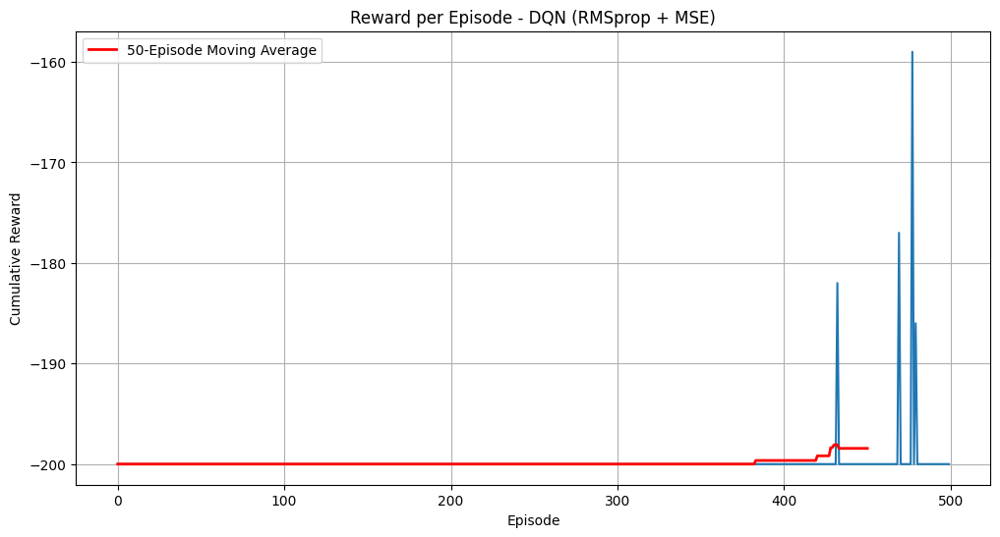

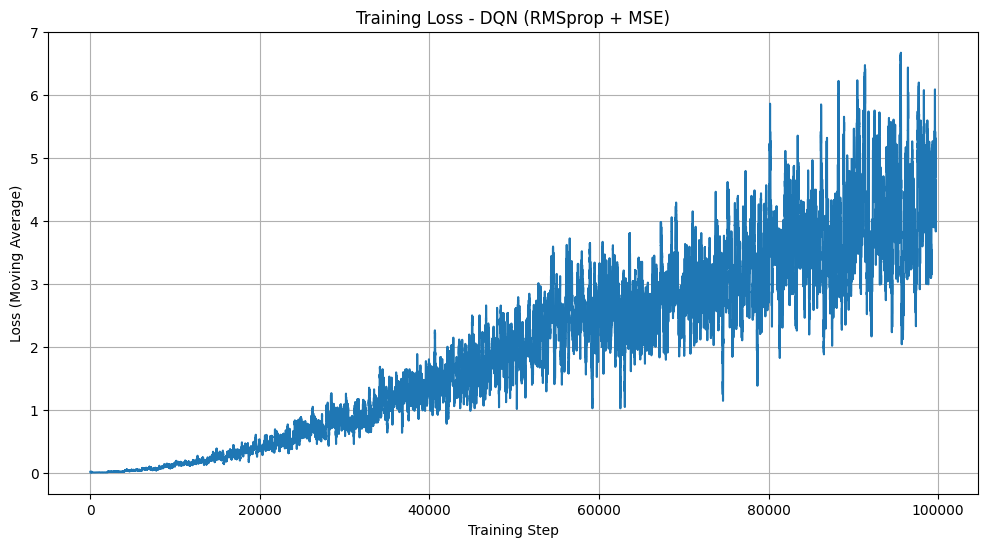

In [ ]:
# ==============================================================================
# --- DQN Experiment 2: RMSprop + MSE ---
# ==============================================================================
print("\n\n--- Starting DQN Training (Experiment 2: RMSprop + MSE) ---")

# Re-initialize the environment and networks for a fresh run
env = gym.make("MountainCar-v0")
policy_net2 = DQN(state_dim, action_dim).to(device)
target_net2 = DQN(state_dim, action_dim).to(device)
target_net2.load_state_dict(policy_net2.state_dict())
target_net2.eval()

#  Use RMSprop optimizer
optimizer2 = optim.RMSprop(policy_net2.parameters(), lr=LEARNING_RATE)
replay_buffer2 = ReplayBuffer()

# Initialize lists for metrics
rewards_dqn2 = []
epsilon_history_dqn2 = []
losses_dqn2 = []

# Start the timer
start_time = time.time()

epsilon = EPSILON_START
for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0

    for step in range(MAX_STEPS_DQN):
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                action = policy_net2(state_tensor).argmax().item()

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated
        episode_reward += reward
        replay_buffer2.push((state, action, reward, next_state, done))
        state = next_state

        if len(replay_buffer2) > BATCH_SIZE:
            states_np, actions_np, rewards_np, next_states_np, dones_np = replay_buffer2.sample(BATCH_SIZE)
            states_tensor = torch.FloatTensor(states_np).to(device)
            actions_tensor = torch.LongTensor(actions_np).to(device)
            rewards_tensor = torch.FloatTensor(rewards_np).to(device)
            next_states_tensor = torch.FloatTensor(next_states_np).to(device)
            dones_tensor = torch.BoolTensor(dones_np).to(device)

            predicted_q_values = policy_net2(states_tensor).gather(1, actions_tensor.unsqueeze(1))

            with torch.no_grad():
                next_q_values = target_net2(next_states_tensor).max(1)[0]
                next_q_values[dones_tensor] = 0.0
                target_q_values = rewards_tensor + (GAMMA * next_q_values)

            loss = F.mse_loss(predicted_q_values.squeeze(), target_q_values)
            losses_dqn2.append(loss.item())

            optimizer2.zero_grad()
            loss.backward()
            optimizer2.step()

        if done:
            break

    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn2.append(episode_reward)
    epsilon_history_dqn2.append(epsilon)

    if episode % TARGET_UPDATE_FREQUENCY == 0:
        target_net2.load_state_dict(policy_net2.state_dict())

    if (episode + 1) % 50 == 0:
        last_50_rewards_mean = np.mean(rewards_dqn2[-50:])
        print(f"Episode {episode + 1}/{N_EPISODES}, Epsilon: {epsilon:.4f}, Avg Reward (last 50): {last_50_rewards_mean:.2f}")

end_time = time.time()
training_time_dqn2 = end_time - start_time
print(f"\nTraining finished in {training_time_dqn2:.2f} seconds.")
env.close()

# --- Evaluation ---
print("\n--- Evaluating DQN Agent (RMSprop + MSE) ---")
eval_env = gym.make("MountainCar-v0")
avg_steps_dqn2, std_steps_dqn2, success_rate_dqn2 = evaluate_agent_detailed(
    eval_env, policy_net2, 'dqn', device=device, max_steps=MAX_STEPS_DQN
)
eval_env.close()
print(f"Success Rate: {success_rate_dqn2:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dqn2:.2f} ± {std_steps_dqn2:.2f}")

# --- Store results ---
results_summary['DQN (RMSprop+MSE)'] = {
    'training_time': training_time_dqn2,
    'avg_steps': avg_steps_dqn2,
    'std_steps': std_steps_dqn2,
    'success_rate': success_rate_dqn2
}

# --- Plotting ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn2)
plt.title('Reward per Episode - DQN (RMSprop + MSE)')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.plot(np.convolve(rewards_dqn2, np.ones(50)/50, mode='valid'), color='red', linewidth=2, label='50-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_dqn2, np.ones(100)/100, mode='valid'))
plt.title('Training Loss - DQN (RMSprop + MSE)')
plt.xlabel('Training Step')
plt.ylabel('Loss (Moving Average)')
plt.grid(True)
plt.show()

## **Experiment 3: Adam + Smooth L1 Loss**



--- Starting DQN Training (Experiment 3: Adam + Smooth L1 Loss) ---
Episode 50/500, Epsilon: 0.7783, Avg Reward (last 50): -200.00
Episode 100/500, Epsilon: 0.6058, Avg Reward (last 50): -200.00
Episode 150/500, Epsilon: 0.4715, Avg Reward (last 50): -200.00
Episode 200/500, Epsilon: 0.3670, Avg Reward (last 50): -200.00
Episode 250/500, Epsilon: 0.2856, Avg Reward (last 50): -200.00
Episode 300/500, Epsilon: 0.2223, Avg Reward (last 50): -200.00
Episode 350/500, Epsilon: 0.1730, Avg Reward (last 50): -200.00
Episode 400/500, Epsilon: 0.1347, Avg Reward (last 50): -200.00
Episode 450/500, Epsilon: 0.1048, Avg Reward (last 50): -199.54
Episode 500/500, Epsilon: 0.0816, Avg Reward (last 50): -194.98

Training finished in 248.24 seconds.

--- Evaluating DQN Agent (Adam + Smooth L1) ---
Success Rate: 0.00%
Average Steps to Goal: nan ± nan


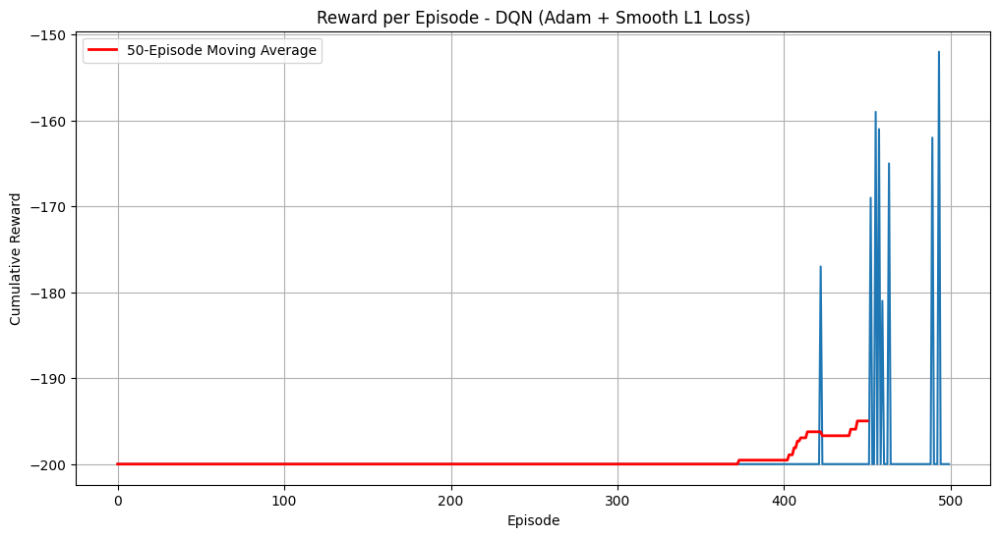

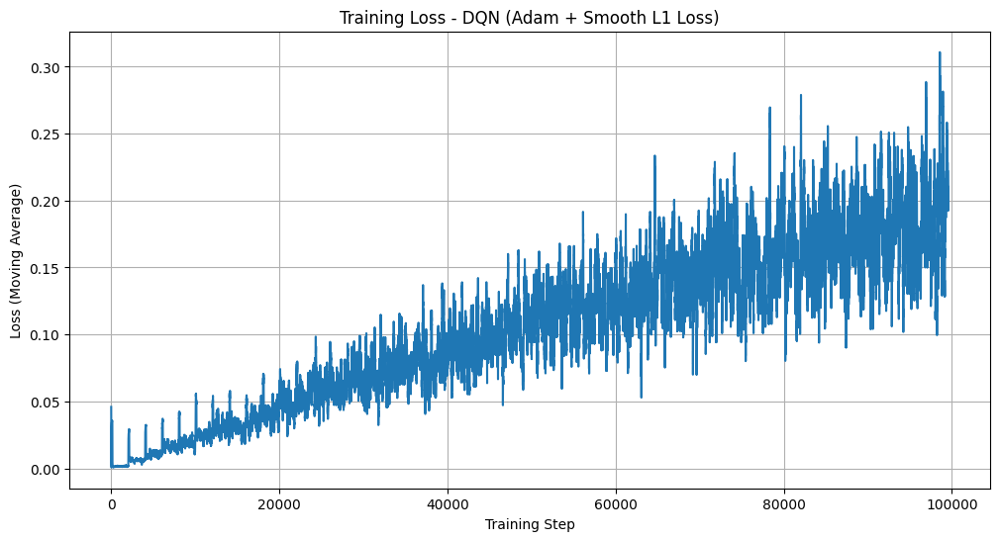

In [ ]:
# ==============================================================================
# --- DQN Experiment 3: Adam + Smooth L1 Loss ---
# ==============================================================================
print("\n\n--- Starting DQN Training (Experiment 3: Adam + Smooth L1 Loss) ---")

# Re-initialize the environment and networks
env = gym.make("MountainCar-v0")
policy_net3 = DQN(state_dim, action_dim).to(device)
target_net3 = DQN(state_dim, action_dim).to(device)
target_net3.load_state_dict(policy_net3.state_dict())
target_net3.eval()

# Use Adam optimizer
optimizer3 = optim.Adam(policy_net3.parameters(), lr=LEARNING_RATE)
replay_buffer3 = ReplayBuffer()

# Initialize lists for metrics
rewards_dqn3 = []
epsilon_history_dqn3 = []
losses_dqn3 = []

# Start the timer
start_time = time.time()

epsilon = EPSILON_START
for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0

    for step in range(MAX_STEPS_DQN):
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                action = policy_net3(state_tensor).argmax().item()

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated
        episode_reward += reward
        replay_buffer3.push((state, action, reward, next_state, done))
        state = next_state

        if len(replay_buffer3) > BATCH_SIZE:
            states_np, actions_np, rewards_np, next_states_np, dones_np = replay_buffer3.sample(BATCH_SIZE)
            states_tensor = torch.FloatTensor(states_np).to(device)
            actions_tensor = torch.LongTensor(actions_np).to(device)
            rewards_tensor = torch.FloatTensor(rewards_np).to(device)
            next_states_tensor = torch.FloatTensor(next_states_np).to(device)
            dones_tensor = torch.BoolTensor(dones_np).to(device)

            predicted_q_values = policy_net3(states_tensor).gather(1, actions_tensor.unsqueeze(1))

            with torch.no_grad():
                next_q_values = target_net3(next_states_tensor).max(1)[0]
                next_q_values[dones_tensor] = 0.0
                target_q_values = rewards_tensor + (GAMMA * next_q_values)

            #  Use Smooth L1 Loss
            loss = F.smooth_l1_loss(predicted_q_values.squeeze(), target_q_values)
            losses_dqn3.append(loss.item())

            optimizer3.zero_grad()
            loss.backward()
            optimizer3.step()

        if done:
            break

    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn3.append(episode_reward)
    epsilon_history_dqn3.append(epsilon)

    if episode % TARGET_UPDATE_FREQUENCY == 0:
        target_net3.load_state_dict(policy_net3.state_dict())

    if (episode + 1) % 50 == 0:
        last_50_rewards_mean = np.mean(rewards_dqn3[-50:])
        print(f"Episode {episode + 1}/{N_EPISODES}, Epsilon: {epsilon:.4f}, Avg Reward (last 50): {last_50_rewards_mean:.2f}")

end_time = time.time()
training_time_dqn3 = end_time - start_time
print(f"\nTraining finished in {training_time_dqn3:.2f} seconds.")
env.close()

# --- Evaluation ---
print("\n--- Evaluating DQN Agent (Adam + Smooth L1) ---")
eval_env = gym.make("MountainCar-v0")
avg_steps_dqn3, std_steps_dqn3, success_rate_dqn3 = evaluate_agent_detailed(
    eval_env, policy_net3, 'dqn', device=device, max_steps=MAX_STEPS_DQN
)
eval_env.close()
print(f"Success Rate: {success_rate_dqn3:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dqn3:.2f} ± {std_steps_dqn3:.2f}")

# --- Store results ---
results_summary['DQN (Adam+SmoothL1)'] = {
    'training_time': training_time_dqn3,
    'avg_steps': avg_steps_dqn3,
    'std_steps': std_steps_dqn3,
    'success_rate': success_rate_dqn3
}

# --- Plotting ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn3)
plt.title('Reward per Episode - DQN (Adam + Smooth L1 Loss)')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.plot(np.convolve(rewards_dqn3, np.ones(50)/50, mode='valid'), color='red', linewidth=2, label='50-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_dqn3, np.ones(100)/100, mode='valid'))
plt.title('Training Loss - DQN (Adam + Smooth L1 Loss)')
plt.xlabel('Training Step')
plt.ylabel('Loss (Moving Average)')
plt.grid(True)
plt.show()

## **Experiment 4: Adam + Smooth L1 + Shaped Reward**



--- Starting DQN Training (Experiment 4: Adam + Smooth L1 + Shaped Reward) ---
Episode 50/500, Epsilon: 0.7783, Avg Reward (last 50): -200.00
Episode 100/500, Epsilon: 0.6058, Avg Reward (last 50): -200.00
Episode 150/500, Epsilon: 0.4715, Avg Reward (last 50): -198.26
Episode 200/500, Epsilon: 0.3670, Avg Reward (last 50): -185.24
Episode 250/500, Epsilon: 0.2856, Avg Reward (last 50): -176.94
Episode 300/500, Epsilon: 0.2223, Avg Reward (last 50): -160.20
Episode 350/500, Epsilon: 0.1730, Avg Reward (last 50): -149.18
Episode 400/500, Epsilon: 0.1347, Avg Reward (last 50): -145.18
Episode 450/500, Epsilon: 0.1048, Avg Reward (last 50): -138.12
Episode 500/500, Epsilon: 0.0816, Avg Reward (last 50): -134.82

Training finished in 209.31 seconds.

--- Evaluating DQN Agent (Adam + Smooth L1 + Shaped Reward) ---
Success Rate: 100.00%
Average Steps to Goal: 133.72 ± 14.43


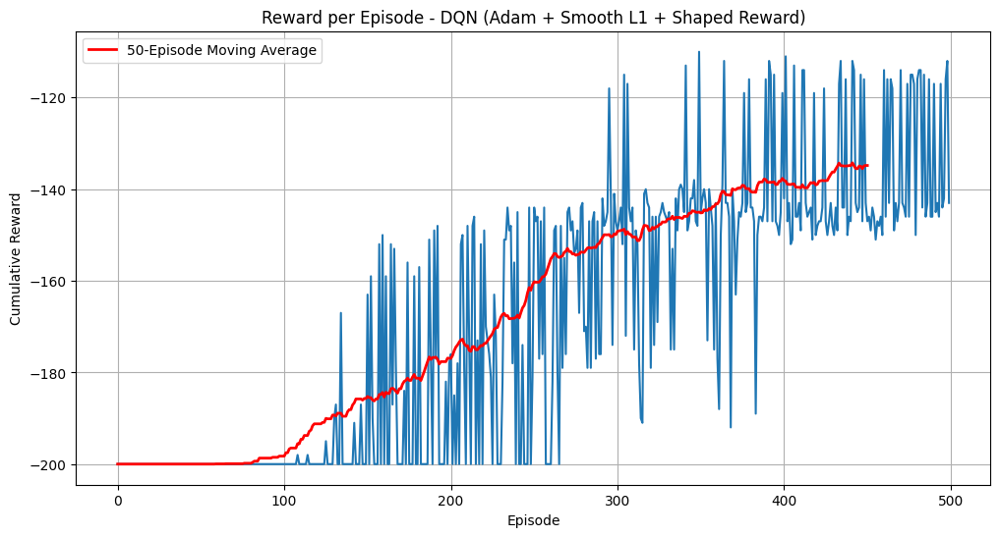

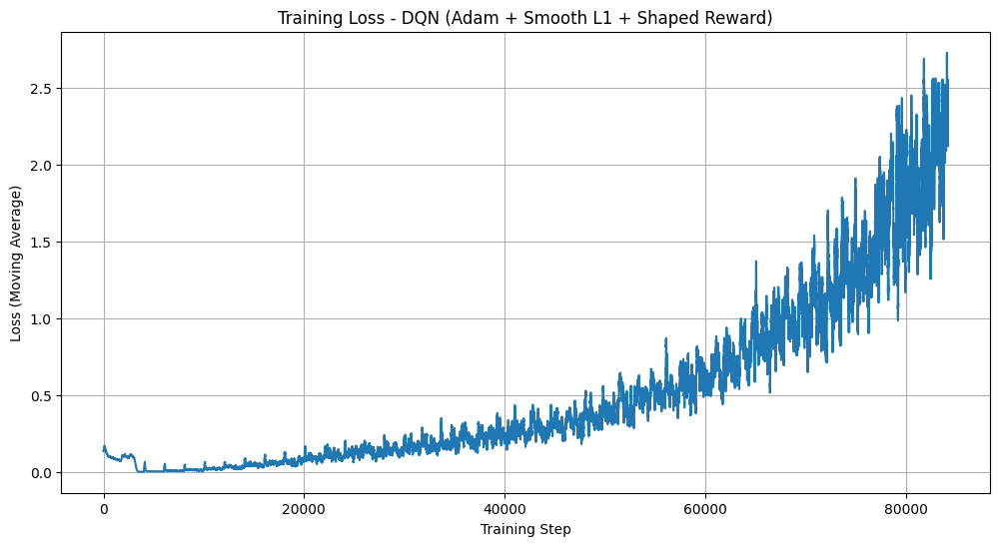

In [ ]:
# ==============================================================================
# --- DQN Experiment 4: Adam + Smooth L1 Loss + Shaped Reward ---
# ==============================================================================
print("\n\n--- Starting DQN Training (Experiment 4: Adam + Smooth L1 + Shaped Reward) ---")

# Re-initialize the environment and networks
env = gym.make("MountainCar-v0")
policy_net4 = DQN(state_dim, action_dim).to(device)
target_net4 = DQN(state_dim, action_dim).to(device)
target_net4.load_state_dict(policy_net4.state_dict())
target_net4.eval()

optimizer4 = optim.Adam(policy_net4.parameters(), lr=LEARNING_RATE)
replay_buffer4 = ReplayBuffer()

# Initialize lists for metrics
rewards_dqn4 = []
epsilon_history_dqn4 = []
losses_dqn4 = []

# Start the timer
start_time = time.time()

epsilon = EPSILON_START
for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0

    for step in range(MAX_STEPS_DQN):
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                action = policy_net4(state_tensor).argmax().item()

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated

        #  Reward Shaping
        shaped_reward = reward + 100 * abs(next_state[1])

        episode_reward += reward # Log original reward for fair comparison

        # Push the SHAPED reward to the buffer
        replay_buffer4.push((state, action, shaped_reward, next_state, done))
        state = next_state

        if len(replay_buffer4) > BATCH_SIZE:
            states_np, actions_np, rewards_np, next_states_np, dones_np = replay_buffer4.sample(BATCH_SIZE)
            states_tensor = torch.FloatTensor(states_np).to(device)
            actions_tensor = torch.LongTensor(actions_np).to(device)
            rewards_tensor = torch.FloatTensor(rewards_np).to(device) # Contains shaped rewards
            next_states_tensor = torch.FloatTensor(next_states_np).to(device)
            dones_tensor = torch.BoolTensor(dones_np).to(device)

            predicted_q_values = policy_net4(states_tensor).gather(1, actions_tensor.unsqueeze(1))

            with torch.no_grad():
                next_q_values = target_net4(next_states_tensor).max(1)[0]
                next_q_values[dones_tensor] = 0.0
                target_q_values = rewards_tensor + (GAMMA * next_q_values)

            loss = F.smooth_l1_loss(predicted_q_values.squeeze(), target_q_values)
            losses_dqn4.append(loss.item())

            optimizer4.zero_grad()
            loss.backward()
            optimizer4.step()

        if done:
            break

    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn4.append(episode_reward)
    epsilon_history_dqn4.append(epsilon)

    if episode % TARGET_UPDATE_FREQUENCY == 0:
        target_net4.load_state_dict(policy_net4.state_dict())

    if (episode + 1) % 50 == 0:
        last_50_rewards_mean = np.mean(rewards_dqn4[-50:])
        print(f"Episode {episode + 1}/{N_EPISODES}, Epsilon: {epsilon:.4f}, Avg Reward (last 50): {last_50_rewards_mean:.2f}")

end_time = time.time()
training_time_dqn4 = end_time - start_time
print(f"\nTraining finished in {training_time_dqn4:.2f} seconds.")
env.close()

# --- Evaluation ---
print("\n--- Evaluating DQN Agent (Adam + Smooth L1 + Shaped Reward) ---")
eval_env = gym.make("MountainCar-v0")
avg_steps_dqn4, std_steps_dqn4, success_rate_dqn4 = evaluate_agent_detailed(
    eval_env, policy_net4, 'dqn', device=device, max_steps=MAX_STEPS_DQN
)
eval_env.close()
print(f"Success Rate: {success_rate_dqn4:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dqn4:.2f} ± {std_steps_dqn4:.2f}")

# --- Store results ---
results_summary['DQN (Adam+SmoothL1+Shaped)'] = {
    'training_time': training_time_dqn4,
    'avg_steps': avg_steps_dqn4,
    'std_steps': std_steps_dqn4,
    'success_rate': success_rate_dqn4
}

# --- Plotting ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn4)
plt.title('Reward per Episode - DQN (Adam + Smooth L1 + Shaped Reward)')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.plot(np.convolve(rewards_dqn4, np.ones(50)/50, mode='valid'), color='red', linewidth=2, label='50-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_dqn4, np.ones(100)/100, mode='valid'))
plt.title('Training Loss - DQN (Adam + Smooth L1 + Shaped Reward)')
plt.xlabel('Training Step')
plt.ylabel('Loss (Moving Average)')
plt.grid(True)
plt.show()

## **Experiment 5: RMSprop + Smooth L1**



--- Starting DQN Training (Experiment 5: RMSprop + Smooth L1) ---
Episode 50/500, Epsilon: 0.7783, Avg Reward (last 50): -200.00
Episode 100/500, Epsilon: 0.6058, Avg Reward (last 50): -200.00
Episode 150/500, Epsilon: 0.4715, Avg Reward (last 50): -200.00
Episode 200/500, Epsilon: 0.3670, Avg Reward (last 50): -200.00
Episode 250/500, Epsilon: 0.2856, Avg Reward (last 50): -200.00
Episode 300/500, Epsilon: 0.2223, Avg Reward (last 50): -200.00
Episode 350/500, Epsilon: 0.1730, Avg Reward (last 50): -200.00
Episode 400/500, Epsilon: 0.1347, Avg Reward (last 50): -200.00
Episode 450/500, Epsilon: 0.1048, Avg Reward (last 50): -200.00
Episode 500/500, Epsilon: 0.0816, Avg Reward (last 50): -200.00

Training finished in 240.22 seconds.

--- Evaluating DQN Agent (RMSprop + Smooth L1) ---
Success Rate: 0.00%
Average Steps to Goal: nan ± nan


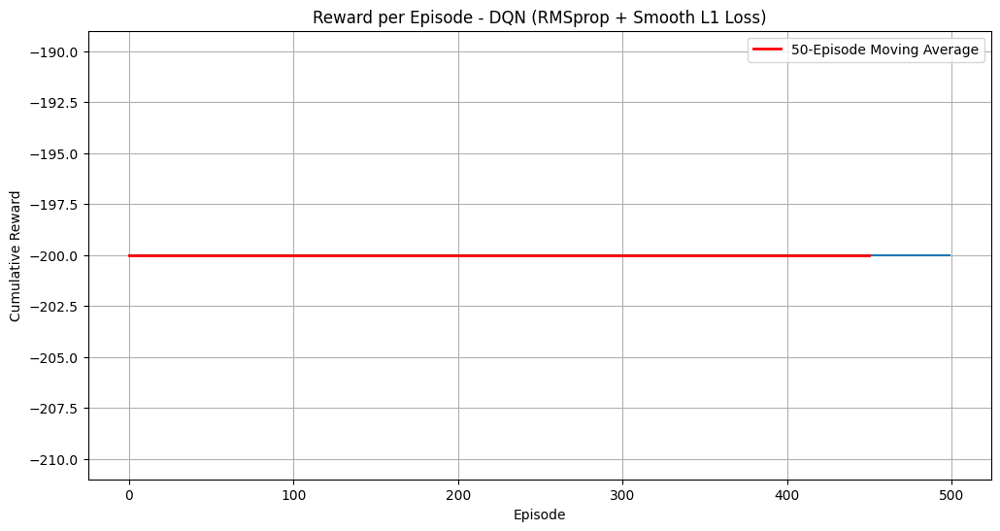

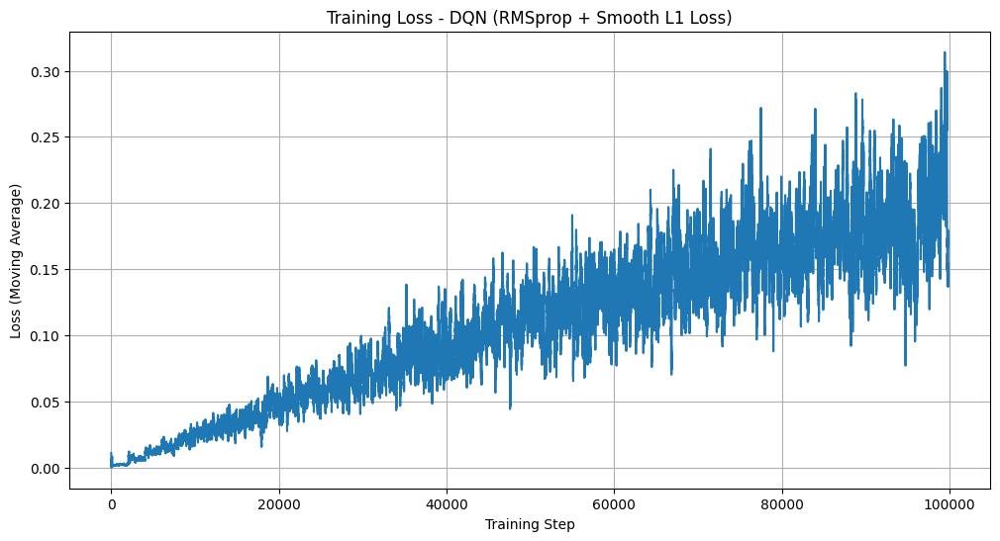

In [ ]:
# ==============================================================================
# --- DQN Experiment 5: RMSprop + Smooth L1 Loss ---
# ==============================================================================
print("\n\n--- Starting DQN Training (Experiment 5: RMSprop + Smooth L1) ---")

# Re-initialize the environment and networks
env = gym.make("MountainCar-v0")
policy_net5 = DQN(state_dim, action_dim).to(device)
target_net5 = DQN(state_dim, action_dim).to(device)
target_net5.load_state_dict(policy_net5.state_dict())
target_net5.eval()

# Use RMSprop optimizer
optimizer5 = optim.RMSprop(policy_net5.parameters(), lr=LEARNING_RATE)
replay_buffer5 = ReplayBuffer()

# Initialize lists for metrics
rewards_dqn5 = []
epsilon_history_dqn5 = []
losses_dqn5 = []

# Start the timer
start_time = time.time()

epsilon = EPSILON_START
for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0

    for step in range(MAX_STEPS_DQN):
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                action = policy_net5(state_tensor).argmax().item()

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated
        episode_reward += reward
        replay_buffer5.push((state, action, reward, next_state, done))
        state = next_state

        if len(replay_buffer5) > BATCH_SIZE:
            states_np, actions_np, rewards_np, next_states_np, dones_np = replay_buffer5.sample(BATCH_SIZE)
            states_tensor = torch.FloatTensor(states_np).to(device)
            actions_tensor = torch.LongTensor(actions_np).to(device)
            rewards_tensor = torch.FloatTensor(rewards_np).to(device)
            next_states_tensor = torch.FloatTensor(next_states_np).to(device)
            dones_tensor = torch.BoolTensor(dones_np).to(device)

            predicted_q_values = policy_net5(states_tensor).gather(1, actions_tensor.unsqueeze(1))

            with torch.no_grad():
                next_q_values = target_net5(next_states_tensor).max(1)[0]
                next_q_values[dones_tensor] = 0.0
                target_q_values = rewards_tensor + (GAMMA * next_q_values)

            # Use Smooth L1 Loss
            loss = F.smooth_l1_loss(predicted_q_values.squeeze(), target_q_values)
            losses_dqn5.append(loss.item())

            optimizer5.zero_grad()
            loss.backward()
            optimizer5.step()

        if done:
            break

    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn5.append(episode_reward)
    epsilon_history_dqn5.append(epsilon)

    if episode % TARGET_UPDATE_FREQUENCY == 0:
        target_net5.load_state_dict(policy_net5.state_dict())

    if (episode + 1) % 50 == 0:
        last_50_rewards_mean = np.mean(rewards_dqn5[-50:])
        print(f"Episode {episode + 1}/{N_EPISODES}, Epsilon: {epsilon:.4f}, Avg Reward (last 50): {last_50_rewards_mean:.2f}")

end_time = time.time()
training_time_dqn5 = end_time - start_time
print(f"\nTraining finished in {training_time_dqn5:.2f} seconds.")
env.close()

# --- Evaluation ---
print("\n--- Evaluating DQN Agent (RMSprop + Smooth L1) ---")
eval_env = gym.make("MountainCar-v0")
avg_steps_dqn5, std_steps_dqn5, success_rate_dqn5 = evaluate_agent_detailed(
    eval_env, policy_net5, 'dqn', device=device, max_steps=MAX_STEPS_DQN
)
eval_env.close()
print(f"Success Rate: {success_rate_dqn5:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dqn5:.2f} ± {std_steps_dqn5:.2f}")

# --- Store results ---
results_summary['DQN (RMSprop+SmoothL1)'] = {
    'training_time': training_time_dqn5,
    'avg_steps': avg_steps_dqn5,
    'std_steps': std_steps_dqn5,
    'success_rate': success_rate_dqn5
}

# --- Plotting ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn5)
plt.title('Reward per Episode - DQN (RMSprop + Smooth L1 Loss)')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.plot(np.convolve(rewards_dqn5, np.ones(50)/50, mode='valid'), color='red', linewidth=2, label='50-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_dqn5, np.ones(100)/100, mode='valid'))
plt.title('Training Loss - DQN (RMSprop + Smooth L1 Loss)')
plt.xlabel('Training Step')
plt.ylabel('Loss (Moving Average)')
plt.grid(True)
plt.show()

## **Experiment 6: Adam + MSE + Shaped Reward**



--- Starting DQN Training (Experiment 6: Adam + MSE + Shaped Reward) ---
Episode 50/500, Epsilon: 0.7783, Avg Reward (last 50): -200.00
Episode 100/500, Epsilon: 0.6058, Avg Reward (last 50): -200.00
Episode 150/500, Epsilon: 0.4715, Avg Reward (last 50): -199.72
Episode 200/500, Epsilon: 0.3670, Avg Reward (last 50): -188.34
Episode 250/500, Epsilon: 0.2856, Avg Reward (last 50): -185.70
Episode 300/500, Epsilon: 0.2223, Avg Reward (last 50): -170.92
Episode 350/500, Epsilon: 0.1730, Avg Reward (last 50): -161.74
Episode 400/500, Epsilon: 0.1347, Avg Reward (last 50): -168.08
Episode 450/500, Epsilon: 0.1048, Avg Reward (last 50): -192.56
Episode 500/500, Epsilon: 0.0816, Avg Reward (last 50): -200.00

Training finished in 232.96 seconds.

--- Evaluating DQN Agent (Adam + MSE + Shaped Reward) ---
Success Rate: 0.00%
Average Steps to Goal: nan ± nan


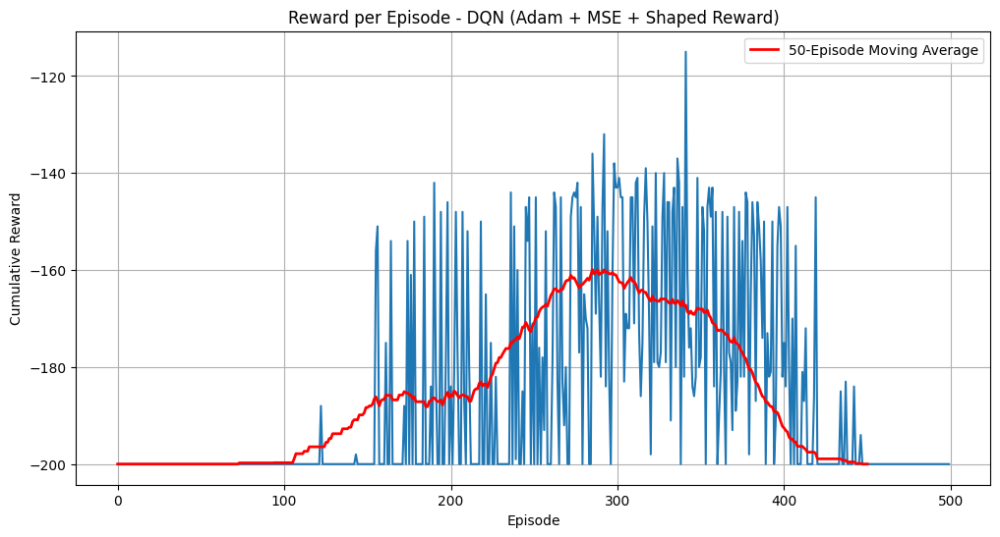

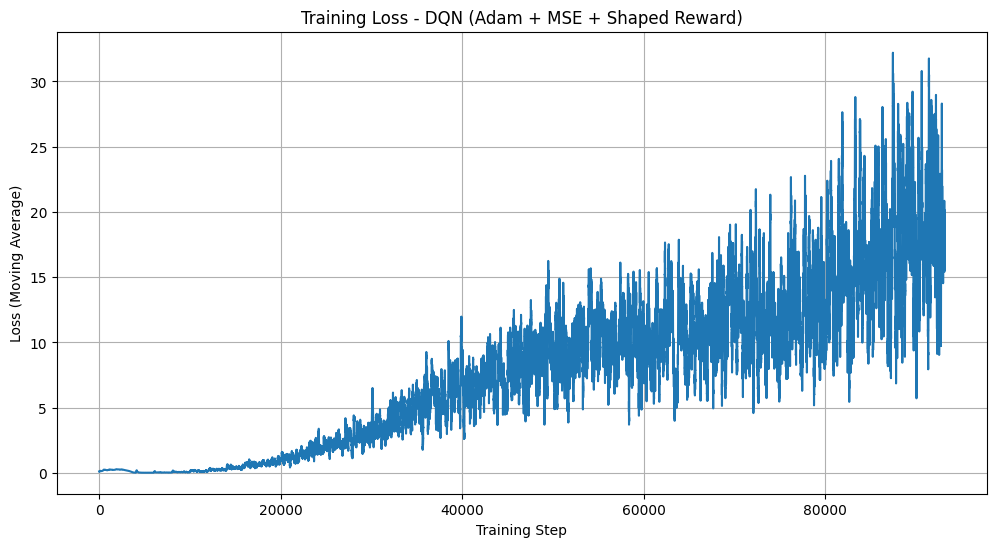

In [ ]:
# ==============================================================================
# --- DQN Experiment 6: Adam + MSE + Shaped Reward ---
# ==============================================================================
print("\n\n--- Starting DQN Training (Experiment 6: Adam + MSE + Shaped Reward) ---")

# Re-initialize the environment and networks
env = gym.make("MountainCar-v0")
policy_net6 = DQN(state_dim, action_dim).to(device)
target_net6 = DQN(state_dim, action_dim).to(device)
target_net6.load_state_dict(policy_net6.state_dict())
target_net6.eval()

optimizer6 = optim.Adam(policy_net6.parameters(), lr=LEARNING_RATE)
replay_buffer6 = ReplayBuffer()

# Initialize lists for metrics
rewards_dqn6 = []
epsilon_history_dqn6 = []
losses_dqn6 = []

# Start the timer
start_time = time.time()

epsilon = EPSILON_START
for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0

    for step in range(MAX_STEPS_DQN):
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        if random.random() < epsilon:
            action = env.action_space.sample()
        else:
            with torch.no_grad():
                action = policy_net6(state_tensor).argmax().item()

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated

        # Reward Shaping
        shaped_reward = reward + 100 * abs(next_state[1])
        episode_reward += reward

        replay_buffer6.push((state, action, shaped_reward, next_state, done))
        state = next_state

        if len(replay_buffer6) > BATCH_SIZE:
            states_np, actions_np, rewards_np, next_states_np, dones_np = replay_buffer6.sample(BATCH_SIZE)
            states_tensor = torch.FloatTensor(states_np).to(device)
            actions_tensor = torch.LongTensor(actions_np).to(device)
            rewards_tensor = torch.FloatTensor(rewards_np).to(device)
            next_states_tensor = torch.FloatTensor(next_states_np).to(device)
            dones_tensor = torch.BoolTensor(dones_np).to(device)

            predicted_q_values = policy_net6(states_tensor).gather(1, actions_tensor.unsqueeze(1))

            with torch.no_grad():
                next_q_values = target_net6(next_states_tensor).max(1)[0]
                next_q_values[dones_tensor] = 0.0
                target_q_values = rewards_tensor + (GAMMA * next_q_values)

            # Use MSE Loss
            loss = F.mse_loss(predicted_q_values.squeeze(), target_q_values)
            losses_dqn6.append(loss.item())

            optimizer6.zero_grad()
            loss.backward()
            optimizer6.step()

        if done:
            break

    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn6.append(episode_reward)
    epsilon_history_dqn6.append(epsilon)

    if episode % TARGET_UPDATE_FREQUENCY == 0:
        target_net6.load_state_dict(policy_net6.state_dict())

    if (episode + 1) % 50 == 0:
        last_50_rewards_mean = np.mean(rewards_dqn6[-50:])
        print(f"Episode {episode + 1}/{N_EPISODES}, Epsilon: {epsilon:.4f}, Avg Reward (last 50): {last_50_rewards_mean:.2f}")

end_time = time.time()
training_time_dqn6 = end_time - start_time
print(f"\nTraining finished in {training_time_dqn6:.2f} seconds.")
env.close()

# --- Evaluation ---
print("\n--- Evaluating DQN Agent (Adam + MSE + Shaped Reward) ---")
eval_env = gym.make("MountainCar-v0")
avg_steps_dqn6, std_steps_dqn6, success_rate_dqn6 = evaluate_agent_detailed(
    eval_env, policy_net6, 'dqn', device=device, max_steps=MAX_STEPS_DQN
)
eval_env.close()
print(f"Success Rate: {success_rate_dqn6:.2f}%")
print(f"Average Steps to Goal: {avg_steps_dqn6:.2f} ± {std_steps_dqn6:.2f}")

# --- Store results ---
results_summary['DQN (Adam+MSE+Shaped)'] = {
    'training_time': training_time_dqn6,
    'avg_steps': avg_steps_dqn6,
    'std_steps': std_steps_dqn6,
    'success_rate': success_rate_dqn6
}

# --- Plotting ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn6)
plt.title('Reward per Episode - DQN (Adam + MSE + Shaped Reward)')
plt.xlabel('Episode')
plt.ylabel('Cumulative Reward')
plt.plot(np.convolve(rewards_dqn6, np.ones(50)/50, mode='valid'), color='red', linewidth=2, label='50-Episode Moving Average')
plt.legend()
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_dqn6, np.ones(100)/100, mode='valid'))
plt.title('Training Loss - DQN (Adam + MSE + Shaped Reward)')
plt.xlabel('Training Step')
plt.ylabel('Loss (Moving Average)')
plt.grid(True)
plt.show()

## **Animation for best**

In [ ]:
# Create a render environment
env_render = gym.make("MountainCar-v0", render_mode='rgb_array')
state, _ = env_render.reset()
done = False
frames = []

while not done:
    frame = env_render.render()
    frames.append(frame)

    # Convert state to a tensor and send to the correct device
    state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)

    # Choose the best action from the BEST trained policy network
    with torch.no_grad():
        action = policy_net4(state_tensor).argmax().item()

    # Perform the action
    state, reward, terminated, truncated, _ = env_render.step(action)
    done = terminated or truncated

env_render.close()

# --- Animation Creation Code ---
from matplotlib.animation import ArtistAnimation
from IPython.display import HTML
import matplotlib.pyplot as plt

fig = plt.figure()
plt.axis('off')

ims = []
for frame in frames:
    im = plt.imshow(frame, animated=True)
    ims.append([im])

anim = ArtistAnimation(fig, ims, interval=30, blit=True, repeat_delay=1000)
plt.close()

# Display the video
HTML(anim.to_jshtml())

# **Continuous Env**

In [ ]:
import gymnasium as gym
import numpy as np

# Create the continuous environment
continuous_env = gym.make("MountainCarContinuous-v0")

# Discretize the continuous action space into 11 separate actions
num_discrete_actions = 11
discrete_action_space = np.linspace(
    continuous_env.action_space.low[0],
    continuous_env.action_space.high[0],
    num_discrete_actions
)

print("Continuous Action Space:", continuous_env.action_space)
print("Our New Discretized Action Space:", discrete_action_space)
print("Number of actions we will use:", len(discrete_action_space))

# Get state and action space dimensions for our new network
state_dim = continuous_env.observation_space.shape[0]
# The action dimension for our DQN is now the number of discrete actions
action_dim = len(discrete_action_space)

print("State dimensions:", state_dim)
print("Action dimensions for DQN:", action_dim)

continuous_env.close()

Continuous Action Space: Box(-1.0, 1.0, (1,), float32)
Our New Discretized Action Space: [-1.         -0.8        -0.6        -0.39999998 -0.19999999  0.
  0.20000005  0.39999998  0.6         0.8000001   1.        ]
Number of actions we will use: 11
State dimensions: 2
Action dimensions for DQN: 11


# **DQN Continuous Env**

--- Starting Discretized DQN on Continuous Env Training ---
Episode 50, Avg Reward: -35.43304133735697
Episode 100, Avg Reward: -27.580481046266826
Episode 150, Avg Reward: -21.511600811052453
Episode 200, Avg Reward: -16.878960663404495
Episode 250, Avg Reward: -13.007360494365692
Episode 300, Avg Reward: -10.280800396013268
Episode 350, Avg Reward: -7.858160295810708
Episode 400, Avg Reward: -6.241680221624383
Episode 450, Avg Reward: -4.796240181121837
Episode 500, Avg Reward: -3.746960148086558
Episode 550, Avg Reward: -2.876560113468179
Episode 600, Avg Reward: -2.2369600941562724
Episode 650, Avg Reward: -1.8197600667381337
Episode 700, Avg Reward: -1.3933600556278267

Training finished in 1782.24 seconds.

--- Running Final Evaluation with Animation ---

FINAL, CORRECTED RESULTS:
Success Rate: 0.00%
Average Steps to Goal: nan ± nan

--- Displaying Evaluation Animation ---


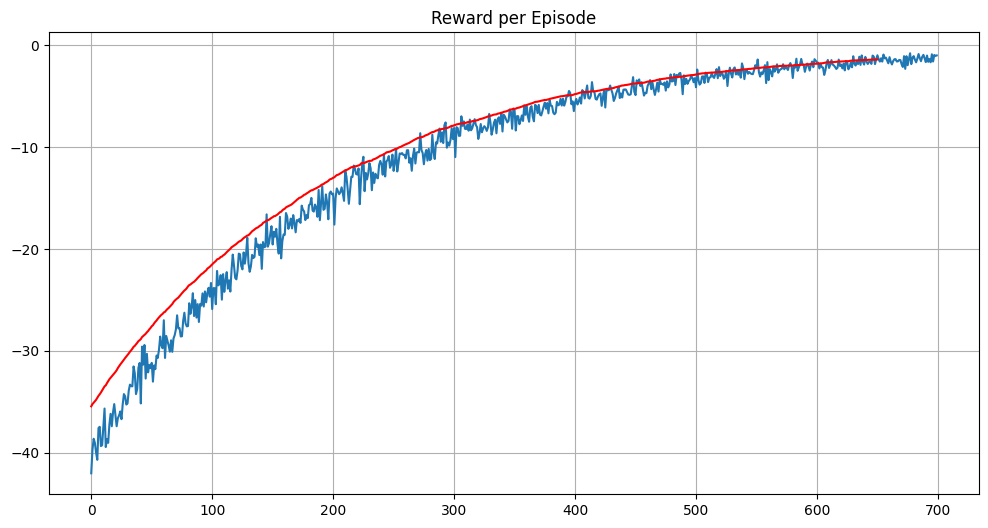

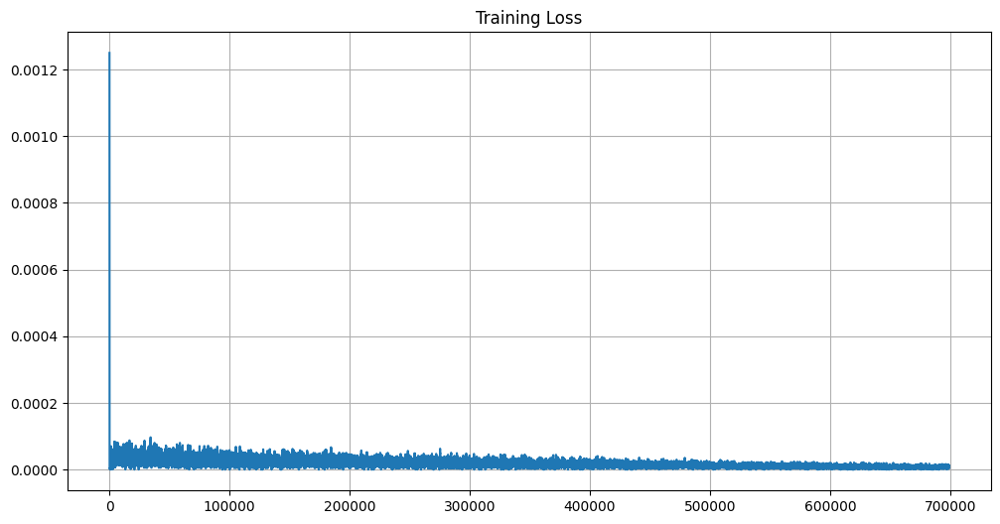

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from collections import deque
import random
import time
import numpy as np
import matplotlib.pyplot as plt
import gymnasium as gym
from IPython.display import HTML
from matplotlib.animation import ArtistAnimation


# --- Setup Classes and Functions ---
class DQN(nn.Module):
    def __init__(self, state_space_dim, action_space_dim):
        super(DQN, self).__init__()
        self.layer1 = nn.Linear(state_space_dim, 128)
        self.layer2 = nn.Linear(128, 64)
        self.layer3 = nn.Linear(64, action_space_dim)
    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        return self.layer3(x)

class ReplayBuffer:
    def __init__(self, capacity=100000): self.buffer = deque(maxlen=capacity)
    def push(self, transition): self.buffer.append(transition)
    def sample(self, batch_size):
        s, a, r, ns, d = zip(*random.sample(self.buffer, batch_size))
        return np.array(s), np.array(a), np.array(r, dtype=np.float32), np.array(ns), np.array(d, dtype=np.uint8)
    def __len__(self): return len(self.buffer)

# --- Training Section ---
print("--- Starting Discretized DQN on Continuous Env Training ---")
env = gym.make("MountainCarContinuous-v0")
num_discrete_actions = 11
discrete_action_space = np.linspace(env.action_space.low[0], env.action_space.high[0], num_discrete_actions)
state_dim_cont = env.observation_space.shape[0]
action_dim_cont = len(discrete_action_space)
max_steps_cont = env.spec.max_episode_steps
env.close()

GAMMA, EPSILON_START, EPSILON_END, EPSILON_DECAY = 0.99, 1.0, 0.01, 0.995
N_EPISODES, LEARNING_RATE, BATCH_SIZE, TARGET_UPDATE_FREQUENCY = 700, 0.001, 64, 10

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
policy_net_cont = DQN(state_dim_cont, action_dim_cont).to(device)
target_net_cont = DQN(state_dim_cont, action_dim_cont).to(device)
target_net_cont.load_state_dict(policy_net_cont.state_dict())
target_net_cont.eval()
optimizer_cont = optim.Adam(policy_net_cont.parameters(), lr=LEARNING_RATE)
replay_buffer_cont = ReplayBuffer()

rewards_dqn_cont, losses_cont = [], []
start_time = time.time()
epsilon = EPSILON_START
env = gym.make("MountainCarContinuous-v0")

for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0
    for step in range(max_steps_cont):
        # Training loop logic... (same as before)
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        if random.random() < epsilon: action_index = random.randrange(action_dim_cont)
        else:
            with torch.no_grad(): action_index = policy_net_cont(state_tensor).argmax().item()
        continuous_action = [discrete_action_space[action_index]]
        next_state, reward, terminated, truncated, _ = env.step(continuous_action)
        done = terminated or truncated
        episode_reward += reward
        replay_buffer_cont.push((state, action_index, reward, next_state, done))
        state = next_state
        if len(replay_buffer_cont) > BATCH_SIZE:
            s_np, a_np, r_np, ns_np, d_np = replay_buffer_cont.sample(BATCH_SIZE)
            s_t, a_t, r_t, ns_t, d_t = torch.FloatTensor(s_np).to(device), torch.LongTensor(a_np).to(device), torch.FloatTensor(r_np).to(device), torch.FloatTensor(ns_np).to(device), torch.BoolTensor(d_np).to(device)
            pred_q = policy_net_cont(s_t).gather(1, a_t.unsqueeze(1))
            with torch.no_grad():
                next_q = target_net_cont(ns_t).max(1)[0]
                next_q[d_t] = 0.0
                target_q = r_t + (GAMMA * next_q)
            loss = F.smooth_l1_loss(pred_q.squeeze(), target_q)
            losses_cont.append(loss.item())
            optimizer_cont.zero_grad()
            loss.backward()
            optimizer_cont.step()
        if done: break
    epsilon = max(EPSILON_END, epsilon * EPSILON_DECAY)
    rewards_dqn_cont.append(episode_reward)
    if episode % TARGET_UPDATE_FREQUENCY == 0: target_net_cont.load_state_dict(policy_net_cont.state_dict())
    if (episode + 1) % 50 == 0: print(f"Episode {episode + 1}, Avg Reward: {np.mean(rewards_dqn_cont[-50:])}")
training_time_cont = time.time() - start_time
print(f"\nTraining finished in {training_time_cont:.2f} seconds.")
env.close()

# ==============================================================================
# --- بخش ارزیابی نهایی به همراه ساخت انیمیشن ---
# ==============================================================================
print("\n--- Running Final Evaluation with Animation ---")
eval_env = gym.make("MountainCarContinuous-v0", render_mode='rgb_array')
trained_model = policy_net_cont
trained_model.eval()
num_eval_episodes = 100
steps_list, success_count = [], 0
evaluation_frames = [] # To store frames for one sample episode

for episode in range(num_eval_episodes):
    state, _ = eval_env.reset(seed=SEED + episode + 500000)
    done, episode_steps = False, 0
    while not done:
        # For the first evaluation episode, record frames
        if episode == 0: evaluation_frames.append(eval_env.render())
        state_tensor = torch.FloatTensor(state).unsqueeze(0).to(device)
        with torch.no_grad(): action_index = trained_model(state_tensor).argmax().item()
        continuous_action = [discrete_action_space[action_index]]
        state, reward, terminated, truncated, _ = eval_env.step(continuous_action)
        done = terminated or truncated
        episode_steps += 1
        if episode_steps >= max_steps_cont: break
    if terminated:
        success_count += 1
        steps_list.append(episode_steps)
eval_env.close()

# --- محاسبه و چاپ نتایج ---
success_rate_final = (success_count / num_eval_episodes) * 100
avg_steps_final = np.mean(steps_list) if steps_list else np.nan
std_steps_final = np.std(steps_list) if steps_list else np.nan
print(f"\nFINAL, CORRECTED RESULTS:")
print(f"Success Rate: {success_rate_final:.2f}%")
print(f"Average Steps to Goal: {avg_steps_final:.2f} ± {std_steps_final:.2f}")

# --- نمایش انیمیشن ارزیابی ---
print("\n--- Displaying Evaluation Animation ---")
fig = plt.figure()
plt.axis('off')
ims = [[plt.imshow(frame, animated=True)] for frame in evaluation_frames]
anim = ArtistAnimation(fig, ims, interval=30, blit=True)
plt.close()
display(HTML(anim.to_jshtml()))

# --- نمایش نمودارهای آموزش ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_dqn_cont)
plt.title('Reward per Episode')
plt.plot(np.convolve(rewards_dqn_cont, np.ones(50)/50, mode='valid'), color='red')
plt.grid(True)
plt.show()

plt.figure(figsize=(12, 6))
plt.plot(np.convolve(losses_cont, np.ones(100)/100, mode='valid'))
plt.title('Training Loss')
plt.grid(True)
plt.show()

# **DDPG**

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Get state and action dimensions from the continuous environment
env = gym.make("MountainCarContinuous-v0")
state_dim = env.observation_space.shape[0]
action_dim = env.action_space.shape[0]
max_action = float(env.action_space.high[0])
env.close()

# DDPG Actor Network Architecture
class Actor(nn.Module):
    def __init__(self, state_dim, action_dim, max_action):
        super(Actor, self).__init__()
        self.layer1 = nn.Linear(state_dim, 256)
        self.layer2 = nn.Linear(256, 128)
        self.layer3 = nn.Linear(128, action_dim)
        self.max_action = max_action

    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        # Use Tanh to output a value between -1 and 1
        x = torch.tanh(self.layer3(x))
        # Scale the output to the environment's action range
        return x * self.max_action

# DDPG Critic Network Architecture
class Critic(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(Critic, self).__init__()
        self.layer1 = nn.Linear(state_dim + action_dim, 256) # Input is state + action
        self.layer2 = nn.Linear(256, 128)
        self.layer3 = nn.Linear(128, 1) # Outputs a single Q-value

    def forward(self, state, action):
        # Concatenate state and action along the last dimension
        x = torch.cat([state, action], 1)
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        return self.layer3(x)


# --- Test the setup ---
actor_model = Actor(state_dim, action_dim, max_action)
critic_model = Critic(state_dim, action_dim)

print("--- Actor Model Architecture ---")
print(actor_model)
print("\n--- Critic Model Architecture ---")
print(critic_model)

--- Actor Model Architecture ---
Actor(
  (layer1): Linear(in_features=2, out_features=256, bias=True)
  (layer2): Linear(in_features=256, out_features=128, bias=True)
  (layer3): Linear(in_features=128, out_features=1, bias=True)
)

--- Critic Model Architecture ---
Critic(
  (layer1): Linear(in_features=3, out_features=256, bias=True)
  (layer2): Linear(in_features=256, out_features=128, bias=True)
  (layer3): Linear(in_features=128, out_features=1, bias=True)
)




--- Starting Final Corrected DDPG Training ---
Episode 20, Average Reward: -1.0250223891830643
Episode 40, Average Reward: -1.020748540208077
Episode 60, Average Reward: -1.0074224646886898
Episode 80, Average Reward: -0.9970946220823649
Episode 100, Average Reward: -0.993924333111838
Episode 120, Average Reward: -1.0040309582703268
Episode 140, Average Reward: -0.981637517006894
Episode 160, Average Reward: -1.006659400120434
Episode 180, Average Reward: -0.9956654537290012
Episode 200, Average Reward: -0.9965144889637599

Training finished in 1178.32 seconds.

--- Evaluating DDPG Agent ---
Success Rate: 0.00%
Average Steps to Goal: nan ± nan


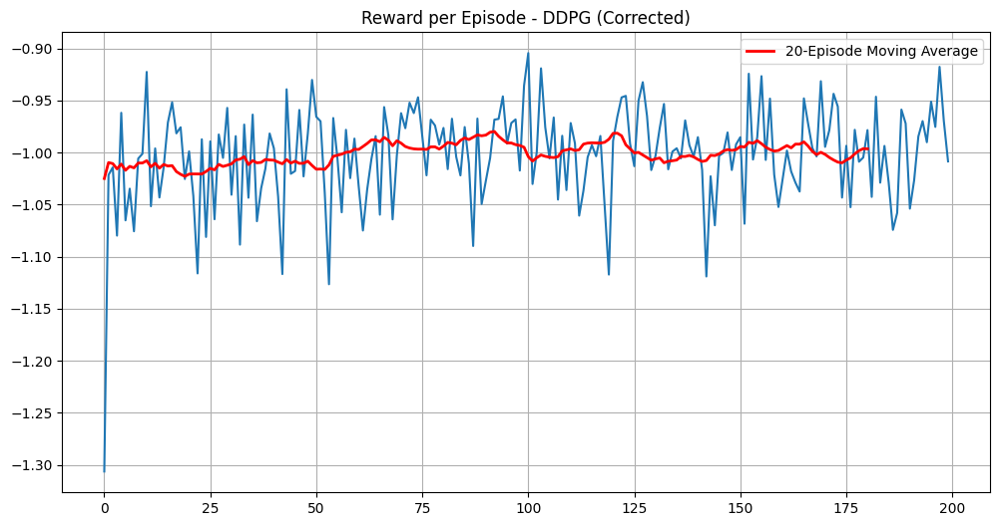

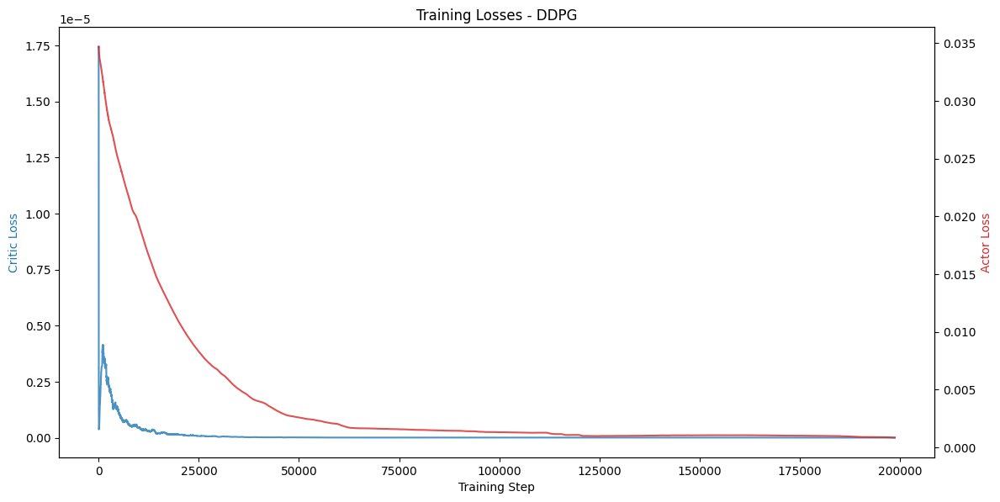

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
import random
from collections import deque
import matplotlib.pyplot as plt
import gymnasium as gym
import time

# ==============================================================================
# --- Class Definitions and Main Script for DDPG ---
# ==============================================================================

class Actor(nn.Module):
    def __init__(self, state_dim, action_dim, max_action):
        super(Actor, self).__init__()
        self.layer1 = nn.Linear(state_dim, 256)
        self.layer2 = nn.Linear(256, 128)
        self.layer3 = nn.Linear(128, action_dim)
        self.max_action = max_action
    def forward(self, x):
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        x = torch.tanh(self.layer3(x)) * self.max_action
        return x

class Critic(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(Critic, self).__init__()
        self.layer1 = nn.Linear(state_dim + action_dim, 256)
        self.layer2 = nn.Linear(256, 128)
        self.layer3 = nn.Linear(128, 1)
    def forward(self, state, action):
        x = torch.cat([state, action], 1)
        x = F.relu(self.layer1(x))
        x = F.relu(self.layer2(x))
        return self.layer3(x)

class ReplayBuffer:
    def __init__(self, capacity):
        self.buffer = deque(maxlen=capacity)

    def push(self, state, action, reward, next_state, done):
        self.buffer.append((state, action, reward, next_state, done))

    def sample(self, batch_size):
        state, action, reward, next_state, done = zip(*random.sample(self.buffer, batch_size))
        return np.array(state), np.array(action), np.array(reward).reshape(-1, 1), np.array(next_state), np.array(done, dtype=np.uint8).reshape(-1, 1)

    def __len__(self):
        return len(self.buffer)

# --- Hyperparameters ---
GAMMA = 0.99
TAU = 0.005
NOISE = 0.1
N_EPISODES = 200
MAX_STEPS = 1000
ACTOR_LR = 1e-4
CRITIC_LR = 1e-3
BATCH_SIZE = 64

# --- Setup ---
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
env = gym.make("MountainCarContinuous-v0")
state_dim = env.observation_space.shape[0]
action_dim = env.action_space.shape[0]
max_action = float(env.action_space.high[0])

# --- Agent Initialization ---
actor = Actor(state_dim, action_dim, max_action).to(device)
actor_target = Actor(state_dim, action_dim, max_action).to(device)
actor_target.load_state_dict(actor.state_dict())
actor_optimizer = optim.Adam(actor.parameters(), lr=ACTOR_LR)

critic = Critic(state_dim, action_dim).to(device)
critic_target = Critic(state_dim, action_dim).to(device)
critic_target.load_state_dict(critic.state_dict())
critic_optimizer = optim.Adam(critic.parameters(), lr=CRITIC_LR)

replay_buffer_ddpg = ReplayBuffer(100000)

def soft_update(local_model, target_model, tau):
    for target_param, local_param in zip(target_model.parameters(), local_model.parameters()):
        target_param.data.copy_(tau * local_param.data + (1.0 - tau) * target_param.data)

# --- Training Loop ---
print("\n\n--- Starting Final Corrected DDPG Training ---")
rewards_ddpg = []
critic_losses = []
actor_losses = []
start_time = time.time()

for episode in range(N_EPISODES):
    state, _ = env.reset(seed=SEED + episode)
    episode_reward = 0
    for t in range(MAX_STEPS):
        with torch.no_grad():
            state_tensor = torch.FloatTensor(state).to(device)
            action = actor(state_tensor).cpu().numpy()

        noise = np.random.normal(0, NOISE, size=action_dim)
        action = (action + noise).clip(env.action_space.low, env.action_space.high)

        next_state, reward, terminated, truncated, _ = env.step(action)
        done = terminated or truncated

        replay_buffer_ddpg.push(state, action, reward, next_state, done)

        if len(replay_buffer_ddpg) > BATCH_SIZE:
            s, a, r, ns, d = replay_buffer_ddpg.sample(BATCH_SIZE)
            s, a, r, ns, d = torch.FloatTensor(s).to(device), torch.FloatTensor(a).to(device), torch.FloatTensor(r).to(device), torch.FloatTensor(ns).to(device), torch.FloatTensor(d).to(device)

            with torch.no_grad():
                target_Q = critic_target(ns, actor_target(ns))
                target_Q = r + ((1 - d) * GAMMA * target_Q)
            current_Q = critic(s, a)
            critic_loss = F.mse_loss(current_Q, target_Q)
            critic_losses.append(critic_loss.item())

            critic_optimizer.zero_grad()
            critic_loss.backward()
            critic_optimizer.step()

            actor_loss = -critic(s, actor(s)).mean()
            actor_losses.append(actor_loss.item())

            actor_optimizer.zero_grad()
            actor_loss.backward()
            actor_optimizer.step()

            soft_update(critic, critic_target, TAU)
            soft_update(actor, actor_target, TAU)

        state = next_state
        episode_reward += reward
        if done: break

    rewards_ddpg.append(episode_reward)
    if (episode + 1) % 20 == 0:
        print(f'Episode {episode+1}, Average Reward: {np.mean(rewards_ddpg[-20:])}')

training_time_ddpg = time.time() - start_time
print(f"\nTraining finished in {training_time_ddpg:.2f} seconds.")
env.close()

# --- Evaluation ---
print("\n--- Evaluating DDPG Agent ---")
def evaluate_ddpg_agent(eval_env, actor_net, num_episodes=100):
    steps_list, success_count = [], 0
    actor_net.eval()
    for episode in range(num_episodes):
        state, _ = eval_env.reset(seed=SEED + episode + 400000)
        done, episode_steps = False, 0
        while not done:
            with torch.no_grad():
                state_tensor = torch.FloatTensor(state).to(device)
                action = actor_net(state_tensor).cpu().numpy()
            state, reward, terminated, truncated, _ = eval_env.step(action)
            done = terminated or truncated
            episode_steps += 1
            if episode_steps >= eval_env.spec.max_episode_steps: break
        if terminated:
            success_count += 1
            steps_list.append(episode_steps)
    actor_net.train()
    if not steps_list: return np.nan, np.nan, 0.0
    return np.mean(steps_list), np.std(steps_list), (success_count / num_episodes) * 100

eval_env = gym.make("MountainCarContinuous-v0")
avg_steps_ddpg, std_steps_ddpg, success_rate_ddpg = evaluate_ddpg_agent(eval_env, actor)
eval_env.close()
print(f"Success Rate: {success_rate_ddpg:.2f}%")
print(f"Average Steps to Goal: {avg_steps_ddpg:.2f} ± {std_steps_ddpg:.2f}")

results_summary['DDPG'] = {
    'training_time': training_time_ddpg,
    'avg_steps': avg_steps_ddpg,
    'std_steps': std_steps_ddpg,
    'success_rate': success_rate_ddpg
}

# --- Plotting ---
plt.figure(figsize=(12, 6))
plt.plot(rewards_ddpg)
plt.title('Reward per Episode - DDPG (Corrected)')
plt.plot(np.convolve(rewards_ddpg, np.ones(20)/20, mode='valid'), color='red', linewidth=2, label='20-Episode Moving Average')
plt.legend(); plt.grid(True); plt.show()

fig, ax1 = plt.subplots(figsize=(12, 6))
ax1.set_xlabel('Training Step'); ax1.set_ylabel('Critic Loss', color='tab:blue')
ax1.plot(np.convolve(critic_losses, np.ones(1000)/1000, mode='valid'), color='tab:blue', alpha=0.8)
ax2 = ax1.twinx()
ax2.set_ylabel('Actor Loss', color='tab:red')
ax2.plot(np.convolve(actor_losses, np.ones(1000)/1000, mode='valid'), color='tab:red', alpha=0.8)
fig.tight_layout(); plt.title('Training Losses - DDPG'); plt.show()